# Micro-Credit Defaulter Model
### Problem Statement: 

A Microfinance Institution (MFI) is an organization that offers financial services to low income populations. MFS becomes very useful when targeting especially the unbanked poor families living in remote areas with not much sources of income. The Microfinance services (MFS) provided by MFI are Group Loans, Agricultural Loans, Individual Business Loans and so on. 

Many microfinance institutions (MFI), experts and donors are supporting the idea of using mobile financial services (MFS) which they feel are more convenient and efficient, and cost saving, than the traditional high-touch model used since long for the purpose of delivering microfinance services. Though, the MFI industry is primarily focusing on low income families and are very useful in such areas, the implementation of MFS has been uneven with both significant challenges and successes.

Today, microfinance is widely accepted as a poverty-reduction tool, representing $70 billion in outstanding loans and a global outreach of 200 million clients.

We are working with one such client that is in Telecom Industry. They are a fixed wireless telecommunications network provider. They have launched various products and have developed its business and organization based on the budget operator model, offering better products at Lower Prices to all value conscious customers through a strategy of disruptive innovation that focuses on the subscriber. 

They understand the importance of communication and how it affects a person’s life, thus, focusing on providing their services and products to low income families and poor customers that can help them in the need of hour. 

They are collaborating with an MFI to provide micro-credit on mobile balances to be paid back in 5 days. The Consumer is believed to be defaulter if he deviates from the path of paying back the loaned amount within the time duration of 5 days. For the loan amount of 5 (in Indonesian Rupiah), payback amount should be 6 (in Indonesian Rupiah), while, for the loan amount of 10 (in Indonesian Rupiah), the payback amount should be 12 (in Indonesian Rupiah). 

The sample data is provided to us from our client database. It is hereby given to you for this exercise. In order to improve the selection of customers for the credit, the client wants some predictions that could help them in further investment and improvement in selection of customers. 

### Exercise:
Build a model which can be used to predict in terms of a probability for each loan transaction, whether the customer will be paying back the loaned amount within 5 days of insurance of loan. In this case, Label ‘1’ indicates that the loan has been payed i.e. Non- defaulter, while, Label ‘0’ indicates that the loan has not been payed i.e. defaulter.  

### Points to Remember:
•	There are no null values in the dataset. 

•	There may be some customers with no loan history. 

•	The dataset is imbalanced. Label ‘1’ has approximately 87.5% records, while, label ‘0’ has approximately 12.5% records.

•	For some features, there may be values which might not be realistic. You may have to observe them and treat them with a suitable explanation.

•	You might come across outliers in some features which you need to handle as per your understanding. Keep in mind that data is expensive and we cannot lose more than 7-8% of the data.  

Find Enclosed the Data Description File and The Sample Data for the Modeling Exercise.

#### Target:
- __label:__	Flag indicating whether the user paid back the credit amount within 5 days of issuing the loan{1:success, 0:failure}

#### Features:
- __msisdn:__	mobile number of user
- __aon:__	age on cellular network in days
- __daily_decr30:__	Daily amount spent from main account, averaged over last 30 days (in Indonesian Rupiah)
- __daily_decr90:__	Daily amount spent from main account, averaged over last 90 days (in Indonesian Rupiah)
- __rental30:__	Average main account balance over last 30 days
- __rental90:__	Average main account balance over last 90 days
- __last_rech_date_ma:__	Number of days till last recharge of main account
- __last_rech_date_da:__	Number of days till last recharge of data account
- __last_rech_amt_ma:__	Amount of last recharge of main account (in Indonesian Rupiah)
- __cnt_ma_rech30:__	Number of times main account got recharged in last 30 days
- __fr_ma_rech30:__	Frequency of main account recharged in last 30 days
- __sumamnt_ma_rech30:__	Total amount of recharge in main account over last 30 days (in Indonesian Rupiah)
- __medianamnt_ma_rech30:__	Median of amount of recharges done in main account over last 30 days at user level (in Indonesian Rupiah)
- __medianmarechprebal30:__	Median of main account balance just before recharge in last 30 days at user level (in Indonesian Rupiah)
- __cnt_ma_rech90:__	Number of times main account got recharged in last 90 days
- __fr_ma_rech90:__	Frequency of main account recharged in last 90 days
- __sumamnt_ma_rech90:__	Total amount of recharge in main account over last 90 days (in Indonasian Rupiah)
- __medianamnt_ma_rech90:__	Median of amount of recharges done in main account over last 90 days at user level (in Indonasian Rupiah)
- __medianmarechprebal90:__	Median of main account balance just before recharge in last 90 days at user level (in Indonasian Rupiah)
- __cnt_da_rech30__:	Number of times data account got recharged in last 30 days
- __fr_da_rech30:__	Frequency of data account recharged in last 30 days
-  __cnt_da_rech90:__	Number of times data account got recharged in last 90 days
- __fr_da_rech90:__	Frequency of data account recharged in last 90 days
- __cnt_loans30:__	Number of loans taken by user in last 30 days
- __amnt_loans30:__	Total amount of loans taken by user in last 30 days
- __maxamnt_loans30:__	maximum amount of loan taken by the user in last 30 days
- __medianamnt_loans30:__	Median of amounts of loan taken by the user in last 30 days
- __cnt_loans90:__	Number of loans taken by user in last 90 days
- __amnt_loans90:__	Total amount of loans taken by user in last 90 days
- __maxamnt_loans90:__	maximum amount of loan taken by the user in last 90 days
- __medianamnt_loans90:__	Median of amounts of loan taken by the user in last 90 days
-  __payback30:__	Average payback time in days over last 30 days
- __payback90:__	Average payback time in days over last 90 days
- __pcircle:__	telecom circle
- __pdate:__	date

# Importing Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
%matplotlib inline
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

from scipy.stats import zscore
from sklearn.preprocessing  import power_transform, StandardScaler, LabelEncoder
from sklearn.feature_selection import VarianceThreshold, SelectKBest, f_classif
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.model_selection import train_test_split, GridSearchCV,cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_curve, auc, roc_auc_score,plot_roc_curve,  accuracy_score, classification_report 
from sklearn.metrics import confusion_matrix, mean_absolute_error, mean_squared_error
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier

import pickle

In [2]:
#To print all columns
pd.set_option('display.max_columns',None)
#To print all rows
pd.set_option('display.max_rows',None)

# Importing the DATASET

In [3]:
defaulter=pd.read_csv("Data file.csv")

# Checking Top 5 rows Data

In [4]:
defaulter.head()

,Unnamed: 0,label,msisdn,aon,daily_decr30,daily_decr90,rental30,rental90,last_rech_date_ma,last_rech_date_da,last_rech_amt_ma,cnt_ma_rech30,fr_ma_rech30,sumamnt_ma_rech30,medianamnt_ma_rech30,medianmarechprebal30,cnt_ma_rech90,fr_ma_rech90,sumamnt_ma_rech90,medianamnt_ma_rech90,medianmarechprebal90,cnt_da_rech30,fr_da_rech30,cnt_da_rech90,fr_da_rech90,cnt_loans30,amnt_loans30,maxamnt_loans30,medianamnt_loans30,cnt_loans90,amnt_loans90,maxamnt_loans90,medianamnt_loans90,payback30,payback90,pcircle,pdate
0,1,0,21408I70789,272.0,3055.050000,3065.150000,220.13,260.13,2.0,0.0,1539,2,21.0,3078.0,1539.0,7.50,2,21,3078,1539.0,7.50,0.0,0.0,0,0,2,12,6.0,0.0,2.0,12,6,0.0,29.000000,29.000000,UPW,2016-07-20
1,2,1,76462I70374,712.0,12122.000000,12124.750000,3691.26,3691.26,20.0,0.0,5787,1,0.0,5787.0,5787.0,61.04,1,0,5787,5787.0,61.04,0.0,0.0,0,0,1,12,12.0,0.0,1.0,12,12,0.0,0.000000,0.000000,UPW,2016-08-10
2,3,1,17943I70372,535.0,1398.000000,1398.000000,900.13,900.13,3.0,0.0,1539,1,0.0,1539.0,1539.0,66.32,1,0,1539,1539.0,66.32,0.0,0.0,0,0,1,6,6.0,0.0,1.0,6,6,0.0,0.000000,0.000000,UPW,2016-08-19
3,4,1,55773I70781,241.0,21.228000,21.228000,159.42,159.42,41.0,0.0,947,0,0.0,0.0,0.0,0.00,1,0,947,947.0,2.50,0.0,0.0,0,0,2,12,6.0,0.0,2.0,12,6,0.0,0.000000,0.000000,UPW,2016-06-06
4,5,1,03813I82730,947.0,150.619333,150.619333,1098.90,1098.90,4.0,0.0,2309,7,2.0,20029.0,2309.0,29.00,8,2,23496,2888.0,35.00,0.0,0.0,0,0,7,42,6.0,0.0,7.0,42,6,0.0,2.333333,2.333333,UPW,2016-06-22


# EDA
## Checking Total Numbers of Rows and Column

In [5]:
defaulter.shape

(209593, 37)

## Checking All Column Name

In [6]:
defaulter.columns

Index(['Unnamed: 0', 'label', 'msisdn', 'aon', 'daily_decr30', 'daily_decr90',
       'rental30', 'rental90', 'last_rech_date_ma', 'last_rech_date_da',
       'last_rech_amt_ma', 'cnt_ma_rech30', 'fr_ma_rech30',
       'sumamnt_ma_rech30', 'medianamnt_ma_rech30', 'medianmarechprebal30',
       'cnt_ma_rech90', 'fr_ma_rech90', 'sumamnt_ma_rech90',
       'medianamnt_ma_rech90', 'medianmarechprebal90', 'cnt_da_rech30',
       'fr_da_rech30', 'cnt_da_rech90', 'fr_da_rech90', 'cnt_loans30',
       'amnt_loans30', 'maxamnt_loans30', 'medianamnt_loans30', 'cnt_loans90',
       'amnt_loans90', 'maxamnt_loans90', 'medianamnt_loans90', 'payback30',
       'payback90', 'pcircle', 'pdate'],
      dtype='object')

## Checking Data Type of All Data

In [7]:
defaulter.dtypes

Unnamed: 0                int64
label                     int64
msisdn                   object
aon                     float64
daily_decr30            float64
daily_decr90            float64
rental30                float64
rental90                float64
last_rech_date_ma       float64
last_rech_date_da       float64
last_rech_amt_ma          int64
cnt_ma_rech30             int64
fr_ma_rech30            float64
sumamnt_ma_rech30       float64
medianamnt_ma_rech30    float64
medianmarechprebal30    float64
cnt_ma_rech90             int64
fr_ma_rech90              int64
sumamnt_ma_rech90         int64
medianamnt_ma_rech90    float64
medianmarechprebal90    float64
cnt_da_rech30           float64
fr_da_rech30            float64
cnt_da_rech90             int64
fr_da_rech90              int64
cnt_loans30               int64
amnt_loans30              int64
maxamnt_loans30         float64
medianamnt_loans30      float64
cnt_loans90             float64
amnt_loans90              int64
maxamnt_

## Checking for Null Values

In [8]:
defaulter.isnull().sum()

Unnamed: 0              0
label                   0
msisdn                  0
aon                     0
daily_decr30            0
daily_decr90            0
rental30                0
rental90                0
last_rech_date_ma       0
last_rech_date_da       0
last_rech_amt_ma        0
cnt_ma_rech30           0
fr_ma_rech30            0
sumamnt_ma_rech30       0
medianamnt_ma_rech30    0
medianmarechprebal30    0
cnt_ma_rech90           0
fr_ma_rech90            0
sumamnt_ma_rech90       0
medianamnt_ma_rech90    0
medianmarechprebal90    0
cnt_da_rech30           0
fr_da_rech30            0
cnt_da_rech90           0
fr_da_rech90            0
cnt_loans30             0
amnt_loans30            0
maxamnt_loans30         0
medianamnt_loans30      0
cnt_loans90             0
amnt_loans90            0
maxamnt_loans90         0
medianamnt_loans90      0
payback30               0
payback90               0
pcircle                 0
pdate                   0
dtype: int64

### Checking for Null Values through heatmap also

<AxesSubplot:>

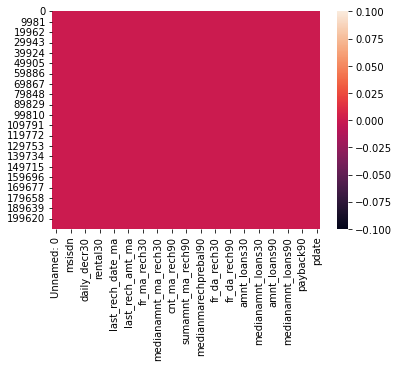

In [9]:
sns.heatmap(defaulter.isnull())

##### We can see there is no Null Values in our dataset.

## Information about Data (Memory Used and Data Types)

In [10]:
defaulter.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 209593 entries, 0 to 209592
Data columns (total 37 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   Unnamed: 0            209593 non-null  int64  
 1   label                 209593 non-null  int64  
 2   msisdn                209593 non-null  object 
 3   aon                   209593 non-null  float64
 4   daily_decr30          209593 non-null  float64
 5   daily_decr90          209593 non-null  float64
 6   rental30              209593 non-null  float64
 7   rental90              209593 non-null  float64
 8   last_rech_date_ma     209593 non-null  float64
 9   last_rech_date_da     209593 non-null  float64
 10  last_rech_amt_ma      209593 non-null  int64  
 11  cnt_ma_rech30         209593 non-null  int64  
 12  fr_ma_rech30          209593 non-null  float64
 13  sumamnt_ma_rech30     209593 non-null  float64
 14  medianamnt_ma_rech30  209593 non-null  float64
 15  

## Checking total number of unique value in each column of Dataset

In [11]:
defaulter.nunique()

Unnamed: 0              209593
label                        2
msisdn                  186243
aon                       4507
daily_decr30            147025
daily_decr90            158669
rental30                132148
rental90                141033
last_rech_date_ma         1186
last_rech_date_da         1174
last_rech_amt_ma            70
cnt_ma_rech30               71
fr_ma_rech30              1083
sumamnt_ma_rech30        15141
medianamnt_ma_rech30       510
medianmarechprebal30     30428
cnt_ma_rech90              110
fr_ma_rech90                89
sumamnt_ma_rech90        31771
medianamnt_ma_rech90       608
medianmarechprebal90     29785
cnt_da_rech30             1066
fr_da_rech30              1072
cnt_da_rech90               27
fr_da_rech90                46
cnt_loans30                 40
amnt_loans30                48
maxamnt_loans30           1050
medianamnt_loans30           6
cnt_loans90               1110
amnt_loans90                69
maxamnt_loans90              3
medianam

We can see that column 'Unnamed: 0' is having unique value for each data so we will drop this column as it is irrelevant for prediction, there is no relation with target

# Descriptive Statistics

In [12]:
# Description of Dataset : works only on continuous column 
defaulter.describe()

,Unnamed: 0,label,aon,daily_decr30,daily_decr90,rental30,rental90,last_rech_date_ma,last_rech_date_da,last_rech_amt_ma,cnt_ma_rech30,fr_ma_rech30,sumamnt_ma_rech30,medianamnt_ma_rech30,medianmarechprebal30,cnt_ma_rech90,fr_ma_rech90,sumamnt_ma_rech90,medianamnt_ma_rech90,medianmarechprebal90,cnt_da_rech30,fr_da_rech30,cnt_da_rech90,fr_da_rech90,cnt_loans30,amnt_loans30,maxamnt_loans30,medianamnt_loans30,cnt_loans90,amnt_loans90,maxamnt_loans90,medianamnt_loans90,payback30,payback90
count,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.00000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000,209593.000000
mean,104797.000000,0.875177,8112.343445,5381.402289,6082.515068,2692.581910,3483.406534,3755.847800,3712.202921,2064.452797,3.978057,3737.355121,7704.501157,1812.817952,3851.927942,6.31543,7.716780,12396.218352,1864.595821,92.025541,262.578110,3749.494447,0.041495,0.045712,2.758981,17.952021,274.658747,0.054029,18.520919,23.645398,6.703134,0.046077,3.398826,4.321485
std,60504.431823,0.330519,75696.082531,9220.623400,10918.812767,4308.586781,5770.461279,53905.892230,53374.833430,2370.786034,4.256090,53643.625172,10139.621714,2070.864620,54006.374433,7.19347,12.590251,16857.793882,2081.680664,369.215658,4183.897978,53885.414979,0.397556,0.951386,2.554502,17.379741,4245.264648,0.218039,224.797423,26.469861,2.103864,0.200692,8.813729,10.308108
min,1.000000,0.000000,-48.000000,-93.012667,-93.012667,-23737.140000,-24720.580000,-29.000000,-29.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-200.000000,0.00000,0.000000,0.000000,0.000000,-200.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,52399.000000,1.000000,246.000000,42.440000,42.692000,280.420000,300.260000,1.000000,0.000000,770.000000,1.000000,0.000000,1540.000000,770.000000,11.000000,2.00000,0.000000,2317.000000,773.000000,14.600000,0.000000,0.000000,0.000000,0.000000,1.000000,6.000000,6.000000,0.000000,1.000000,6.000000,6.000000,0.000000,0.000000,0.000000
50%,104797.000000,1.000000,527.000000,1469.175667,1500.000000,1083.570000,1334.000000,3.000000,0.000000,1539.000000,3.000000,2.000000,4628.000000,1539.000000,33.900000,4.00000,2.000000,7226.000000,1539.000000,36.000000,0.000000,0.000000,0.000000,0.000000,2.000000,12.000000,6.000000,0.000000,2.000000,12.000000,6.000000,0.000000,0.000000,1.666667
75%,157195.000000,1.000000,982.000000,7244.000000,7802.790000,3356.940000,4201.790000,7.000000,0.000000,2309.000000,5.000000,6.000000,10010.000000,1924.000000,83.000000,8.00000,8.000000,16000.000000,1924.000000,79.310000,0.000000,0.000000,0.000000,0.000000,4.000000,24.000000,6.000000,0.000000,5.000000,30.000000,6.000000,0.000000,3.750000,4.500000
max,209593.000000,1.000000,999860.755168,265926.000000,320630.000000,198926.110000,200148.110000,998650.377733,999171.809410,55000.000000,203.000000,999606.368132,810096.000000,55000.000000,999479.419319,336.00000,88.000000,953036.000000,55000.000000,41456.500000,99914.441420,999809.240107,38.000000,64.000000,50.000000,306.000000,99864.560864,3.000000,4997.517944,438.000000,12.000000,3.000000,171.500000,171.500000


#### Observation:
- Total no of rows are 209593 and columns are 37.
- We can check that 34 columns contains Continuous data and 3 columns contains Categorical data.

### Checking Description through heatmap also

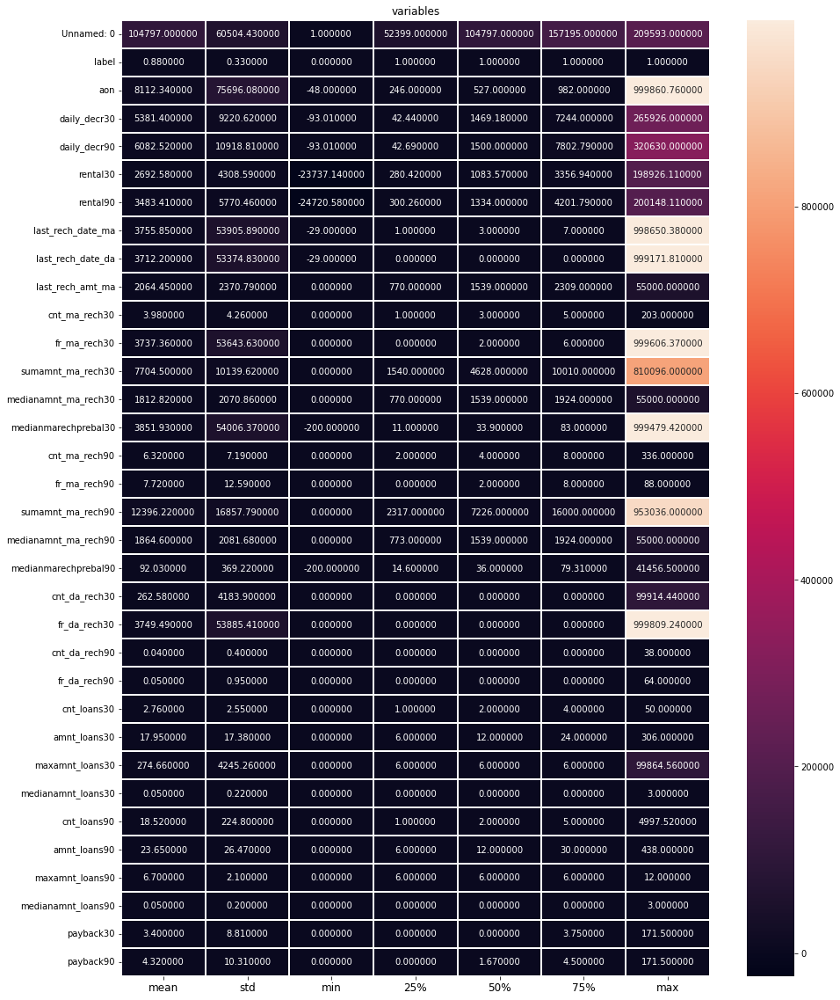

In [13]:
plt.figure(figsize=(15,20))
sns.heatmap(round(defaulter.describe()[1:].transpose(),2),linewidth=2,annot=True,fmt='f')
plt.xticks(fontsize=18)
plt.xticks(fontsize=12)
plt.title('variables')
plt.show()

#### Observation:
- We can see that there are skewness and outliers are present as there are negative values in our dataset and also difference of 25%, 50% & 75% is more in columns ('aon', 'daily_decr30', 'daily_decr90', 'rental30', 'rental90', 'last_rech_date_ma', 'fr_ma_rech30', 'sumamnt_ma_rech30', 'amnt_loans90')
- Here also we can see that in columns ('last_rech_date_da', 'cnt_da_rech30', 'fr_da_rech30', 'cnt_da_rech90', 'fr_da_rech90', 'maxamnt_loans30', 'medianamnt_loans30', 'maxamnt_loans90', 'medianamnt_loans90', 'payback30') 25%, 50% and 75% values are 0.

# Data Cleaning and preprocessing

#### Dropping column 'Unnamed: 0'

In [14]:
defaulter.drop(columns=['Unnamed: 0'],inplace=True)

#### Checking all value of column 'pcircle'

In [15]:
defaulter['pcircle'].value_counts()

UPW    209593
Name: pcircle, dtype: int64

##### We can see that column 'pcircle' is containing only one type of data which is not important for prediction. So, droping this column.

In [16]:
defaulter.drop(columns=['pcircle'],inplace=True)

In [17]:
# checking again total rows and column
defaulter.shape

(209593, 35)

#### column 'pdate' is an object data type, So, we need to convert this data type to a datetime data type for prediction.

In [18]:
#converting data type from object to datetime 
defaulter['pdate']=pd.to_datetime(defaulter['pdate'])

#### Extracting year from pdate

In [19]:
#mapping year values from column 'pdate' to 'year' column in main dataframe
defaulter['year']=defaulter['pdate'].apply(lambda y:y.year)

#### Extracting month  from pdate

In [20]:
#mapping year values from column 'pdate' to 'month' column in main dataframe
defaulter['month']=defaulter['pdate'].apply(lambda m:m.month)

#### Extracting day from pdate

In [21]:
#mapping Day values from column 'pdate' to 'day' column in main dataframe
defaulter['day']=defaulter['pdate'].apply(lambda d:d.day)

#### Droping column "Date_of_Journey" after extracting Day and Month

In [22]:
defaulter.drop(columns=['pdate'],inplace=True)

In [23]:
# checking again top 5 rows of dataset
defaulter.head()

,label,msisdn,aon,daily_decr30,daily_decr90,rental30,rental90,last_rech_date_ma,last_rech_date_da,last_rech_amt_ma,cnt_ma_rech30,fr_ma_rech30,sumamnt_ma_rech30,medianamnt_ma_rech30,medianmarechprebal30,cnt_ma_rech90,fr_ma_rech90,sumamnt_ma_rech90,medianamnt_ma_rech90,medianmarechprebal90,cnt_da_rech30,fr_da_rech30,cnt_da_rech90,fr_da_rech90,cnt_loans30,amnt_loans30,maxamnt_loans30,medianamnt_loans30,cnt_loans90,amnt_loans90,maxamnt_loans90,medianamnt_loans90,payback30,payback90,year,month,day
0,0,21408I70789,272.0,3055.050000,3065.150000,220.13,260.13,2.0,0.0,1539,2,21.0,3078.0,1539.0,7.50,2,21,3078,1539.0,7.50,0.0,0.0,0,0,2,12,6.0,0.0,2.0,12,6,0.0,29.000000,29.000000,2016,7,20
1,1,76462I70374,712.0,12122.000000,12124.750000,3691.26,3691.26,20.0,0.0,5787,1,0.0,5787.0,5787.0,61.04,1,0,5787,5787.0,61.04,0.0,0.0,0,0,1,12,12.0,0.0,1.0,12,12,0.0,0.000000,0.000000,2016,8,10
2,1,17943I70372,535.0,1398.000000,1398.000000,900.13,900.13,3.0,0.0,1539,1,0.0,1539.0,1539.0,66.32,1,0,1539,1539.0,66.32,0.0,0.0,0,0,1,6,6.0,0.0,1.0,6,6,0.0,0.000000,0.000000,2016,8,19
3,1,55773I70781,241.0,21.228000,21.228000,159.42,159.42,41.0,0.0,947,0,0.0,0.0,0.0,0.00,1,0,947,947.0,2.50,0.0,0.0,0,0,2,12,6.0,0.0,2.0,12,6,0.0,0.000000,0.000000,2016,6,6
4,1,03813I82730,947.0,150.619333,150.619333,1098.90,1098.90,4.0,0.0,2309,7,2.0,20029.0,2309.0,29.00,8,2,23496,2888.0,35.00,0.0,0.0,0,0,7,42,6.0,0.0,7.0,42,6,0.0,2.333333,2.333333,2016,6,22


In [24]:
#checking values of year column
defaulter['year'].value_counts()

2016    209593
Name: year, dtype: int64

#### We can see there is only one type of value that is 2016, thus it is irrelavant for prediction. So, will drop this column

In [25]:
defaulter.drop(columns=['year'],inplace=True)

#### Checking all values of column 'msisdn'

In [26]:
defaulter['msisdn'].value_counts()

04581I85330    7
47819I90840    7
30080I90588    6
55809I89238    6
22038I88658    6
43096I88688    6
87592I84456    6
94119I84456    6
43430I70786    6
67324I84453    6
42825I88688    6
29191I82738    6
71742I90843    6
60744I91197    6
30487I89233    5
37897I89236    5
62379I70789    5
12125I88650    5
61990I84451    5
12700I84456    5
95753I95203    5
20036I82735    5
34362I70785    5
48545I85320    5
78109I96341    5
66307I85348    5
32674I82739    5
90144I85348    5
46484I84453    5
63085I90845    5
24906I70786    5
25840I70786    5
14389I70786    5
54218I70377    5
88892I70372    5
46895I84453    5
43945I84452    5
48516I70784    5
01339I70375    5
89501I89232    5
61951I88658    5
24248I70782    5
37054I90580    5
30832I85330    5
60650I85320    5
80215I90584    5
78160I89231    5
01394I90843    5
59873I88689    5
88560I95202    5
34525I90581    5
22713I91197    5
87521I70788    5
91642I84457    5
07747I90581    5
12582I89235    5
87267I70787    5
45099I84456    5
15458I85329   

We can see that this column is not relevant for prediction. So, will drop this column too.

In [27]:
defaulter.drop(columns=['msisdn'],inplace=True)

In [28]:
# checking again total rows and column
defaulter.shape

(209593, 35)

In [29]:
# checking again columns name
defaulter.columns

Index(['label', 'aon', 'daily_decr30', 'daily_decr90', 'rental30', 'rental90',
       'last_rech_date_ma', 'last_rech_date_da', 'last_rech_amt_ma',
       'cnt_ma_rech30', 'fr_ma_rech30', 'sumamnt_ma_rech30',
       'medianamnt_ma_rech30', 'medianmarechprebal30', 'cnt_ma_rech90',
       'fr_ma_rech90', 'sumamnt_ma_rech90', 'medianamnt_ma_rech90',
       'medianmarechprebal90', 'cnt_da_rech30', 'fr_da_rech30',
       'cnt_da_rech90', 'fr_da_rech90', 'cnt_loans30', 'amnt_loans30',
       'maxamnt_loans30', 'medianamnt_loans30', 'cnt_loans90', 'amnt_loans90',
       'maxamnt_loans90', 'medianamnt_loans90', 'payback30', 'payback90',
       'month', 'day'],
      dtype='object')

In [30]:
defaulter.dtypes

label                     int64
aon                     float64
daily_decr30            float64
daily_decr90            float64
rental30                float64
rental90                float64
last_rech_date_ma       float64
last_rech_date_da       float64
last_rech_amt_ma          int64
cnt_ma_rech30             int64
fr_ma_rech30            float64
sumamnt_ma_rech30       float64
medianamnt_ma_rech30    float64
medianmarechprebal30    float64
cnt_ma_rech90             int64
fr_ma_rech90              int64
sumamnt_ma_rech90         int64
medianamnt_ma_rech90    float64
medianmarechprebal90    float64
cnt_da_rech30           float64
fr_da_rech30            float64
cnt_da_rech90             int64
fr_da_rech90              int64
cnt_loans30               int64
amnt_loans30              int64
maxamnt_loans30         float64
medianamnt_loans30      float64
cnt_loans90             float64
amnt_loans90              int64
maxamnt_loans90           int64
medianamnt_loans90      float64
payback3

#### Now, we can see after cleaning data that there are only continuous values in our dataset

# Data Visualization
## Univariate Analysis
### Using Countplot 

<AxesSubplot:xlabel='label', ylabel='count'>

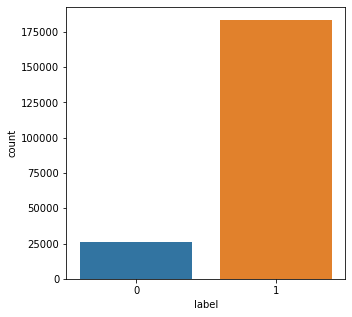

In [31]:
plt.figure(figsize=(5,5))
sns.countplot(x='label', data=defaulter)

- Non-Defaulter are most and Defaulter are least
- We can see more than 175000 is Non-Defaulter and 25000 is Defaulter

### Using Histplot

<AxesSubplot:xlabel='aon', ylabel='Count'>

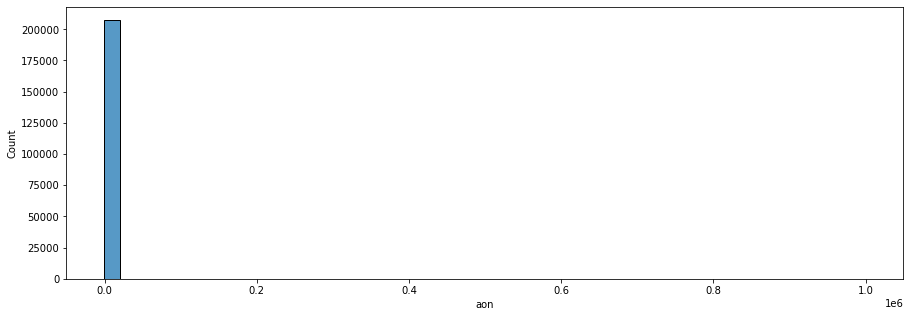

In [32]:
plt.figure(figsize=(15,5))
sns.histplot(x='aon', data=defaulter, bins=50)

More than 200000 is age on cellular network in days

<AxesSubplot:xlabel='daily_decr30', ylabel='Count'>

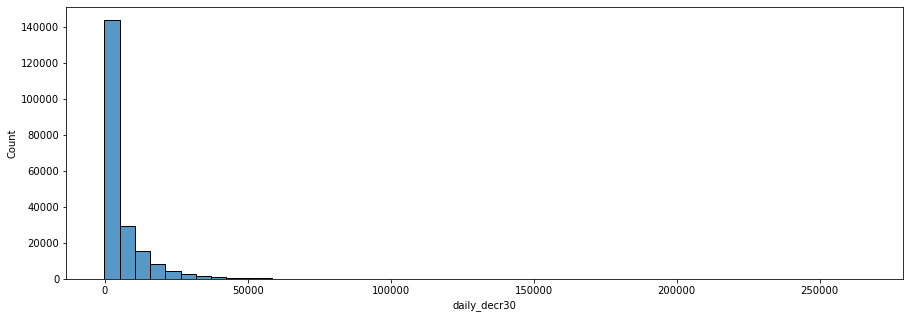

In [33]:
plt.figure(figsize=(15,5))
sns.histplot(x='daily_decr30', data=defaulter, bins=50)

More than 140000 Daily amount spent from main account, averaged over last 30 days (in Indonesian Rupiah)

<AxesSubplot:xlabel='daily_decr90', ylabel='Count'>

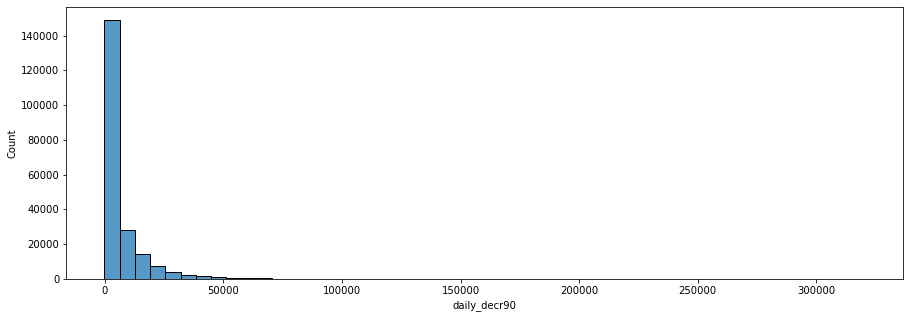

In [34]:
plt.figure(figsize=(15,5))
sns.histplot(x='daily_decr90', data=defaulter, bins=50)

More than 140000 Daily amount spent from main account, averaged over last 90 days (in Indonesian Rupiah)

<AxesSubplot:xlabel='rental30', ylabel='Count'>

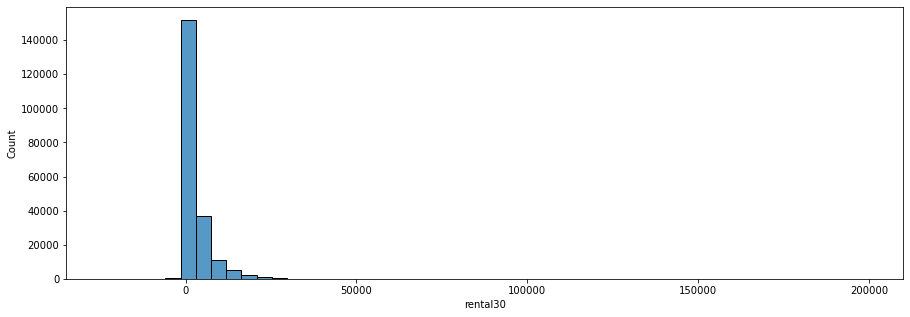

In [35]:
plt.figure(figsize=(15,5))
sns.histplot(x='rental30', data=defaulter, bins=50)

More than 140000 is Average main account balance over last 30 days

<AxesSubplot:xlabel='rental90', ylabel='Count'>

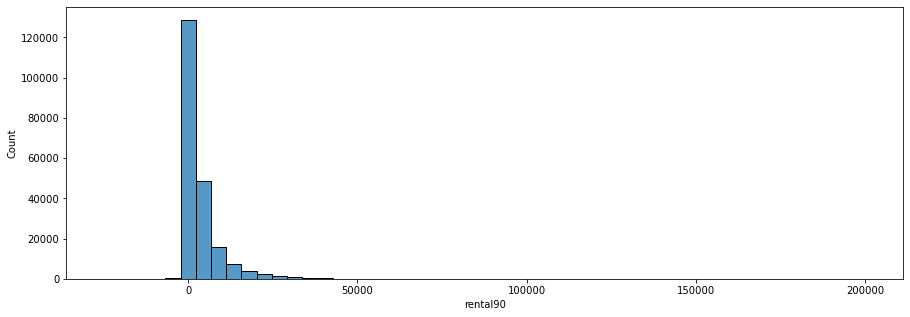

In [36]:
plt.figure(figsize=(15,5))
sns.histplot(x='rental90', data=defaulter, bins=50)

More than 120000 is Average main account balance over last 90 days

<AxesSubplot:xlabel='last_rech_date_ma', ylabel='Count'>

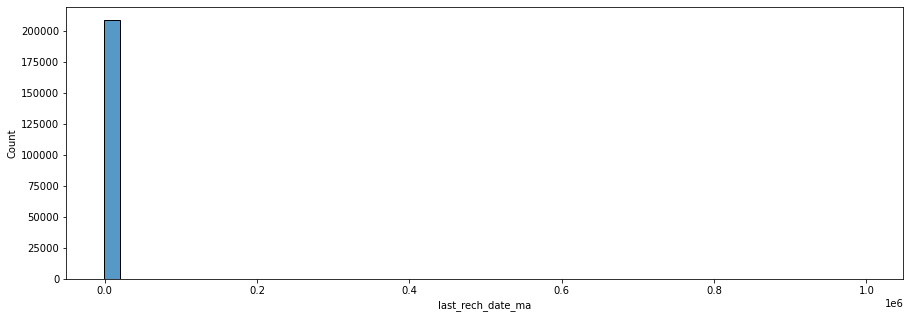

In [37]:
plt.figure(figsize=(15,5))
sns.histplot(x='last_rech_date_ma', data=defaulter, bins=50)

More than 200000 is Number of days till last recharge of main account

<AxesSubplot:xlabel='last_rech_date_da', ylabel='Count'>

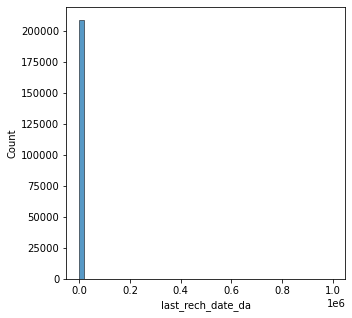

In [38]:
plt.figure(figsize=(5,5))
sns.histplot(x='last_rech_date_da', data=defaulter, bins=50)

More than 200000 is Number of days till last recharge of data account

<AxesSubplot:xlabel='last_rech_amt_ma', ylabel='Count'>

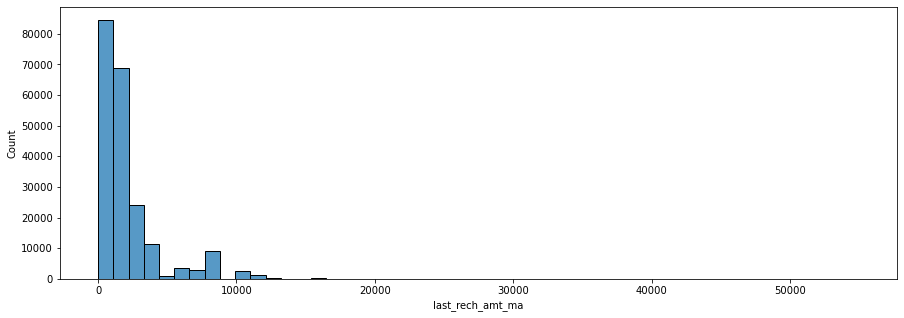

In [39]:
plt.figure(figsize=(15,5))
sns.histplot(x='last_rech_amt_ma', data=defaulter, bins=50)

More than 80000 is Amount of last recharge of main account (in Indonesian Rupiah)

<AxesSubplot:xlabel='cnt_ma_rech30', ylabel='Count'>

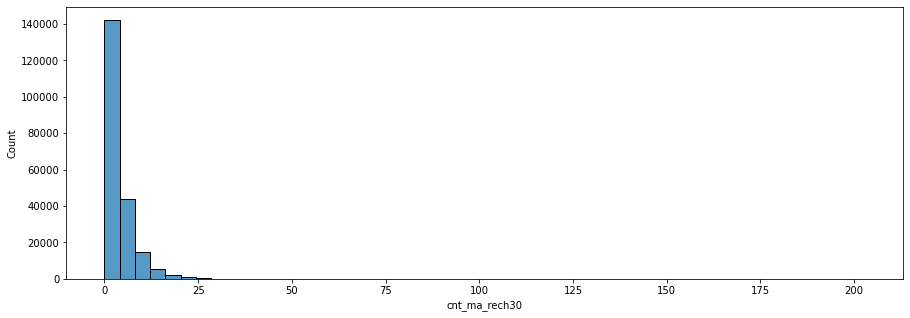

In [40]:
plt.figure(figsize=(15,5))
sns.histplot(x='cnt_ma_rech30', data=defaulter, bins=50)

More than 140000 is Number of times main account got recharged in last 30 days

<AxesSubplot:xlabel='fr_ma_rech30', ylabel='Count'>

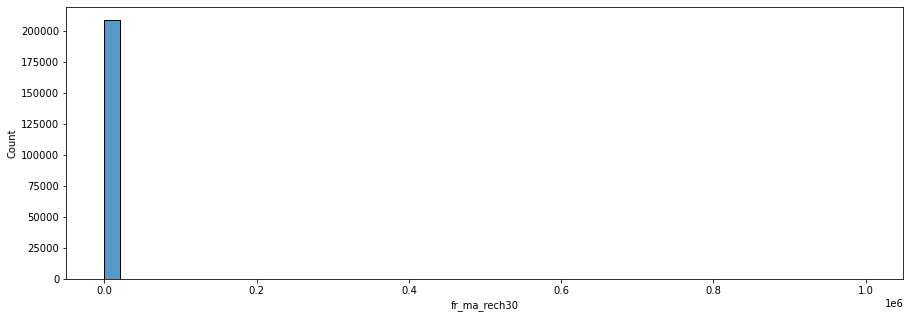

In [41]:
plt.figure(figsize=(15,5))
sns.histplot(x='fr_ma_rech30', data=defaulter, bins=50)

More than 200000 is Frequency of main account recharged in last 30 days

<AxesSubplot:xlabel='sumamnt_ma_rech30', ylabel='Count'>

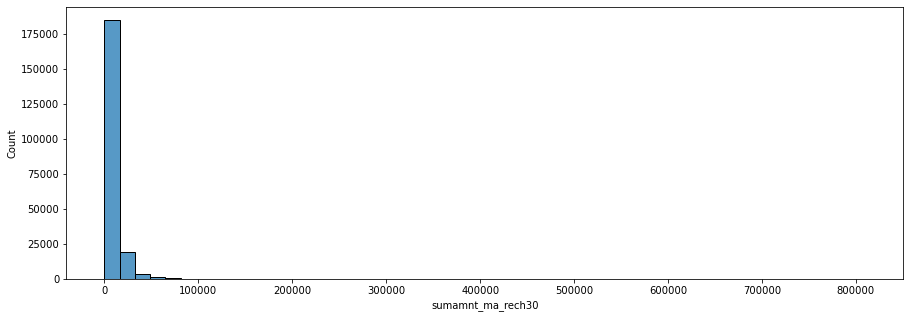

In [42]:
plt.figure(figsize=(15,5))
sns.histplot(x='sumamnt_ma_rech30', data=defaulter, bins=50)

More than 175000 is Total amount of recharge in main account over last 30 days (in Indonesian Rupiah)

<AxesSubplot:xlabel='medianamnt_ma_rech30', ylabel='Count'>

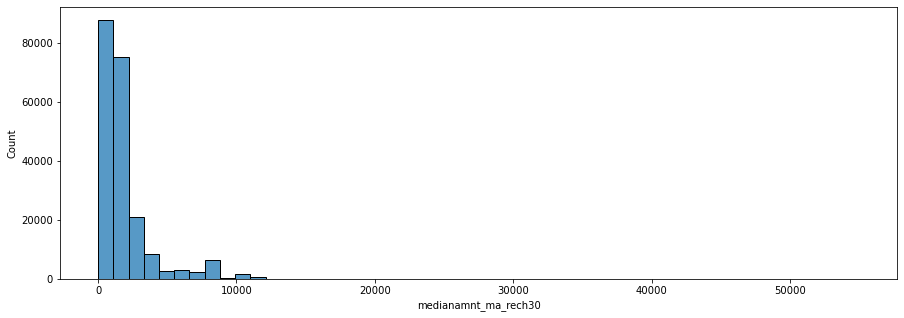

In [43]:
plt.figure(figsize=(15,5))
sns.histplot(x='medianamnt_ma_rech30', data=defaulter, bins=50)

More than 80000 is Median of amount of recharges done in main account over last 30 days at user level (in Indonesian Rupiah)

<AxesSubplot:xlabel='medianmarechprebal30', ylabel='Count'>

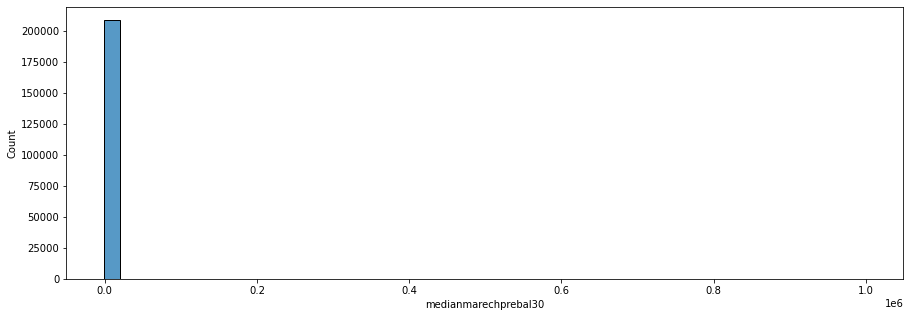

In [44]:
plt.figure(figsize=(15,5))
sns.histplot(x='medianmarechprebal30', data=defaulter, bins=50)

More than 200000 is Median of main account balance just before recharge in last 30 days at user level (in Indonesian Rupiah)

<AxesSubplot:xlabel='cnt_ma_rech90', ylabel='Count'>

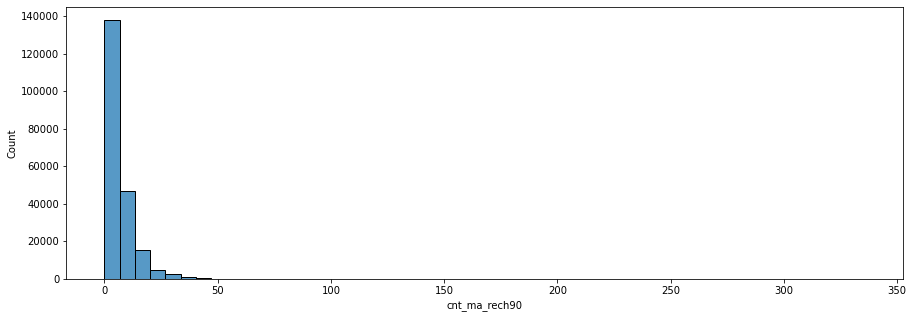

In [45]:
plt.figure(figsize=(15,5))
sns.histplot(x='cnt_ma_rech90', data=defaulter, bins=50)

More than 138000 is Number of times main account got recharged in last 90 days

<AxesSubplot:xlabel='fr_ma_rech90', ylabel='Count'>

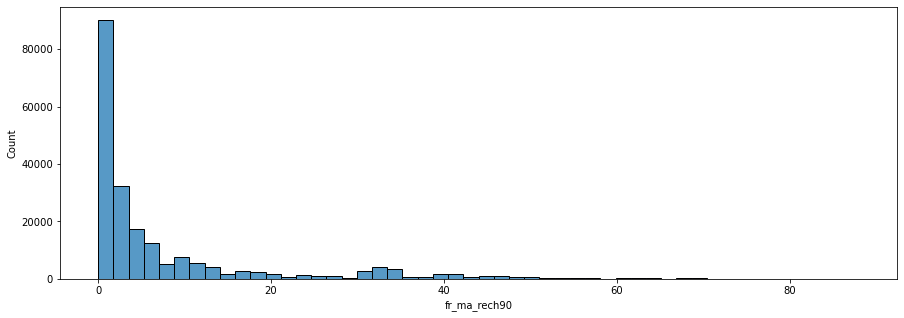

In [46]:
plt.figure(figsize=(15,5))
sns.histplot(x='fr_ma_rech90', data=defaulter, bins=50)

More than 80000 is Frequency of main account recharged in last 90 days

<AxesSubplot:xlabel='sumamnt_ma_rech90', ylabel='Count'>

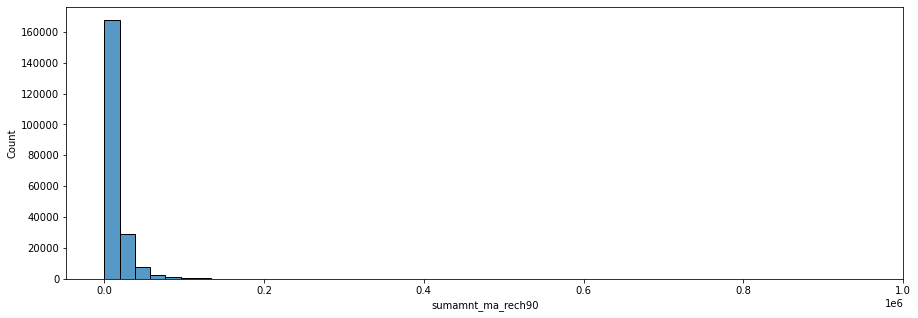

In [47]:
plt.figure(figsize=(15,5))
sns.histplot(x='sumamnt_ma_rech90', data=defaulter, bins=50)

More than 160000 is Total amount of recharge in main account over last 90 days (in Indonasian Rupiah)

<AxesSubplot:xlabel='medianamnt_ma_rech90', ylabel='Count'>

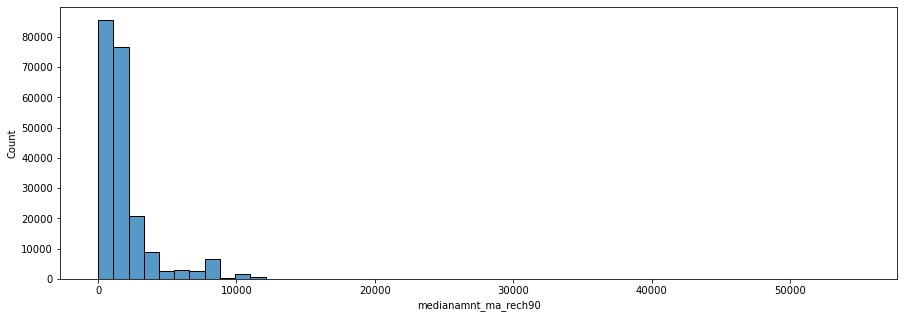

In [48]:
plt.figure(figsize=(15,5))
sns.histplot(x='medianamnt_ma_rech90', data=defaulter, bins=50)

More than 80000 is Median of amount of recharges done in main account over last 90 days at user level (in Indonasian Rupiah)

<AxesSubplot:xlabel='cnt_da_rech30', ylabel='Count'>

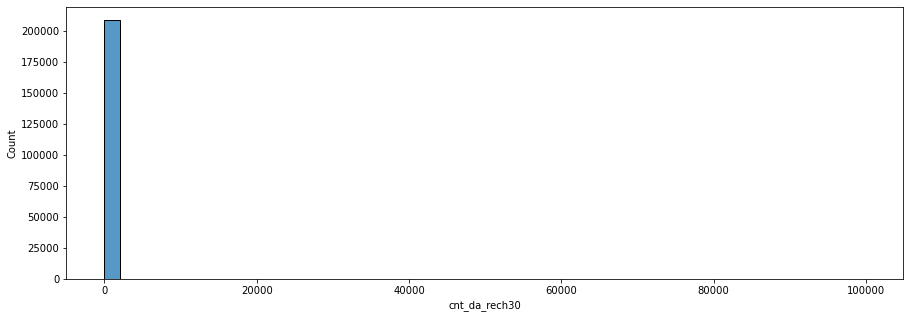

In [49]:
plt.figure(figsize=(15,5))
sns.histplot(x='cnt_da_rech30', data=defaulter, bins=50)

More than 200000 is Number of times data account got recharged in last 30 days

<AxesSubplot:xlabel='fr_da_rech30', ylabel='Count'>

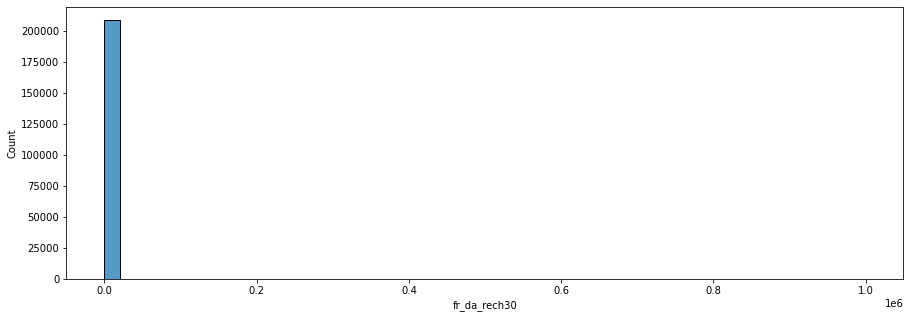

In [50]:
plt.figure(figsize=(15,5))
sns.histplot(x='fr_da_rech30', data=defaulter, bins=50)

More than 200000 is Frequency of data account recharged in last 30 days

<AxesSubplot:xlabel='cnt_da_rech90', ylabel='Count'>

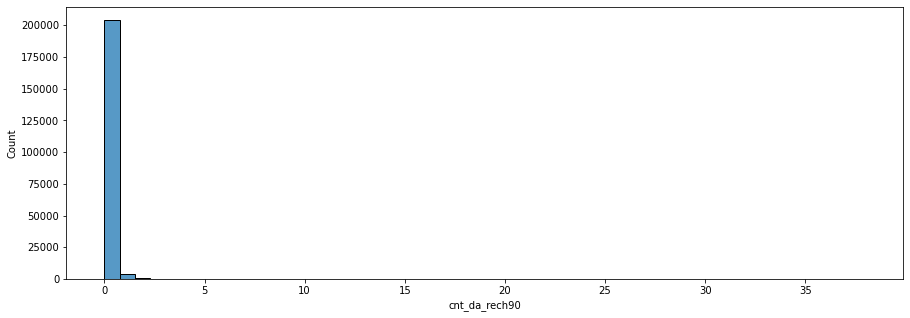

In [51]:
plt.figure(figsize=(15,5))
sns.histplot(x='cnt_da_rech90', data=defaulter, bins=50)

More than 200000 is Number of times data account got recharged in last 90 days

<AxesSubplot:xlabel='fr_da_rech90', ylabel='Count'>

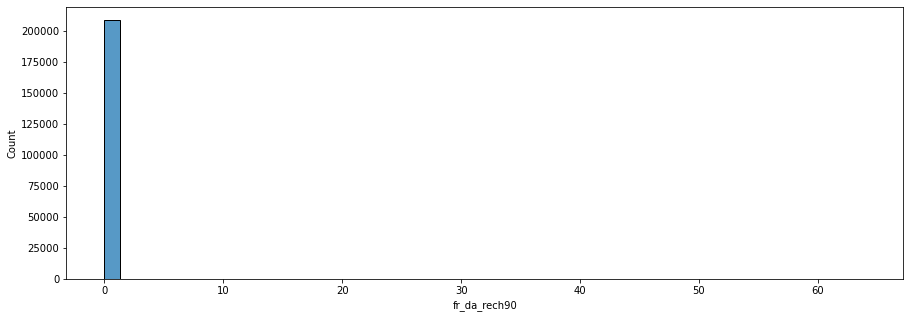

In [52]:
plt.figure(figsize=(15,5))
sns.histplot(x='fr_da_rech90', data=defaulter, bins=50)

More than 200000 is Frequency of data account recharged in last 90 days

<AxesSubplot:xlabel='cnt_loans30', ylabel='Count'>

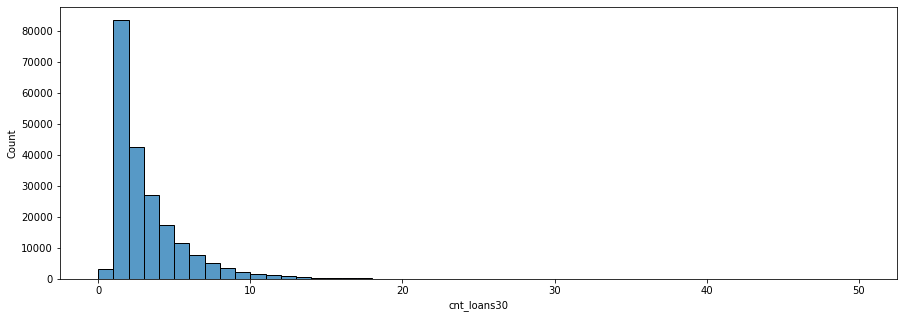

In [53]:
plt.figure(figsize=(15,5))
sns.histplot(x='cnt_loans30', data=defaulter, bins=50)

More than 80000 is Number of loans taken by user in last 30 days

<AxesSubplot:xlabel='amnt_loans30', ylabel='Count'>

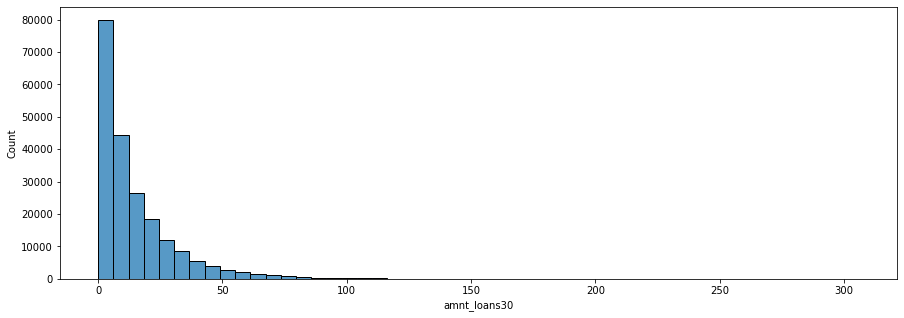

In [54]:
plt.figure(figsize=(15,5))
sns.histplot(x='amnt_loans30', data=defaulter, bins=50)

Mostly 80000 is Total amount of loans taken by user in last 30 days

<AxesSubplot:xlabel='maxamnt_loans30', ylabel='Count'>

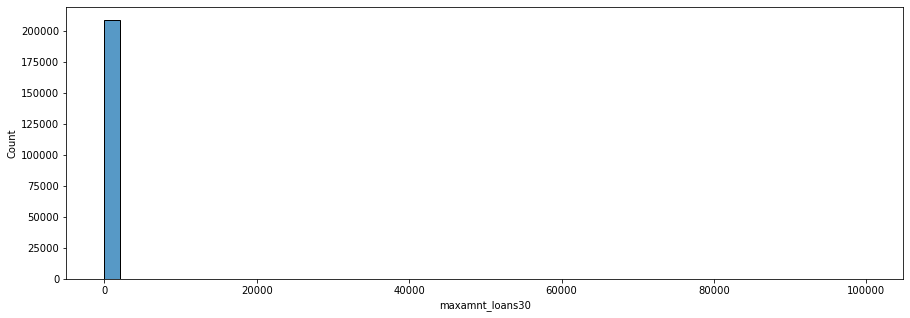

In [55]:
plt.figure(figsize=(15,5))
sns.histplot(x='maxamnt_loans30', data=defaulter, bins=50)

More than 200000 is maximum amount of loan taken by the user in last 30 days

<AxesSubplot:xlabel='medianamnt_loans30', ylabel='Count'>

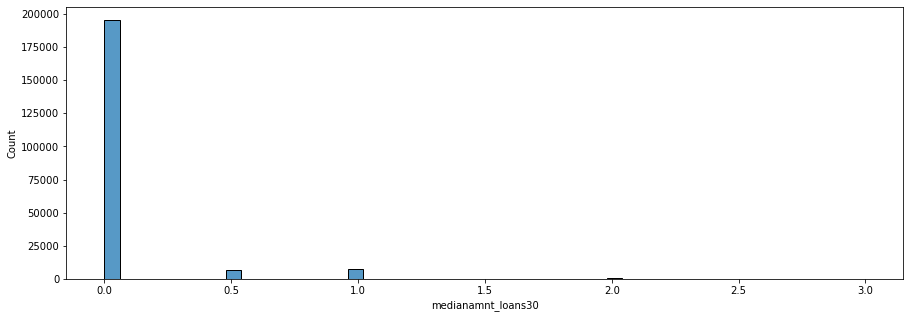

In [56]:
plt.figure(figsize=(15,5))
sns.histplot(x='medianamnt_loans30', data=defaulter, bins=50)

Mostly 19800 is Median of amounts of loan taken by the user in last 30 days

<AxesSubplot:xlabel='cnt_loans90', ylabel='Count'>

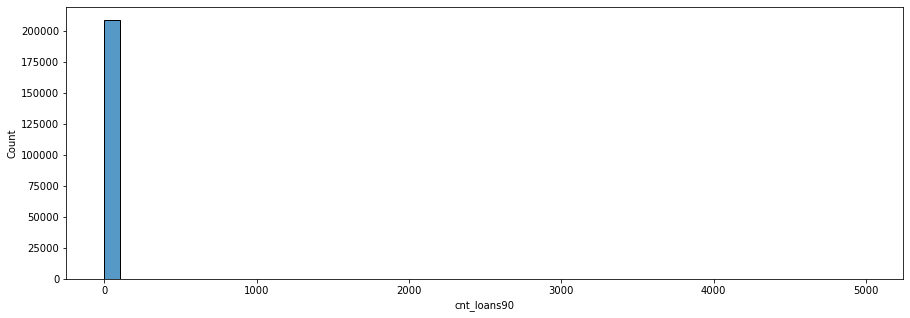

In [57]:
plt.figure(figsize=(15,5))
sns.histplot(x='cnt_loans90', data=defaulter, bins=50)

More than 200000 is Number of loans taken by user in last 90 days

<AxesSubplot:xlabel='amnt_loans90', ylabel='Count'>

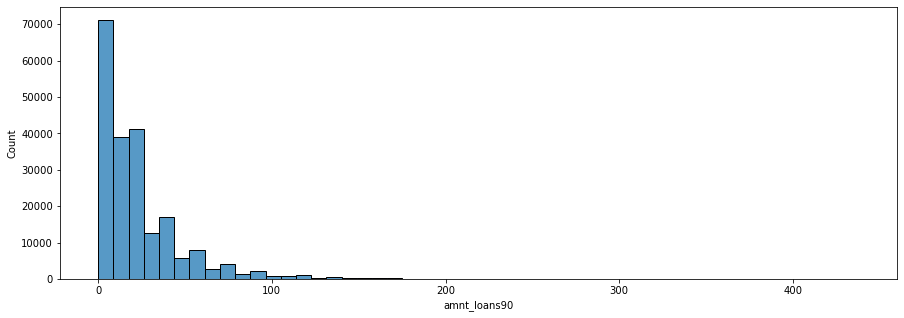

In [58]:
plt.figure(figsize=(15,5))
sns.histplot(x='amnt_loans90', data=defaulter, bins=50)

Mostly 71000 is Total amount of loans taken by user in last 90 days

<AxesSubplot:xlabel='maxamnt_loans90', ylabel='Count'>

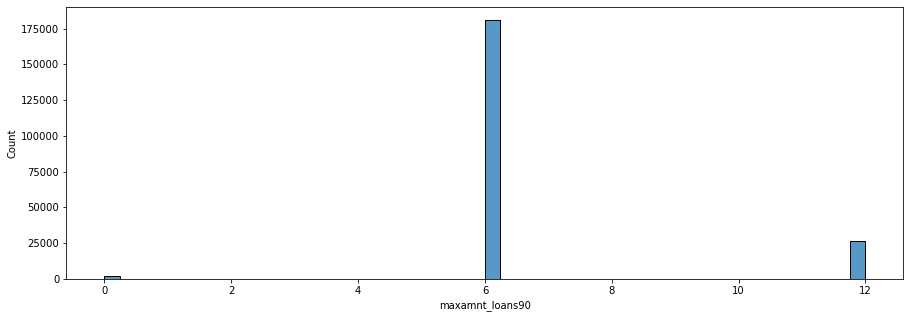

In [59]:
plt.figure(figsize=(15,5))
sns.histplot(x='maxamnt_loans90', data=defaulter, bins=50)

More than 175000 is maximum amount of loan taken by the user in last 90 days

<AxesSubplot:xlabel='medianamnt_loans90', ylabel='Count'>

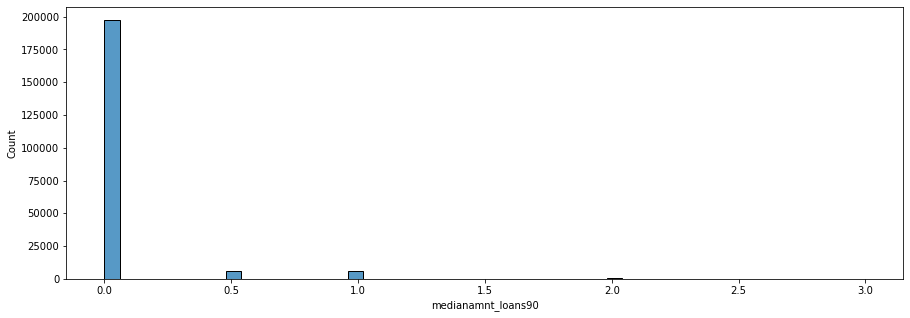

In [60]:
plt.figure(figsize=(15,5))
sns.histplot(x='medianamnt_loans90', data=defaulter, bins=50)

Mostly 198000 is Median of amounts of loan taken by the user in last 90 days

<AxesSubplot:xlabel='payback30', ylabel='Count'>

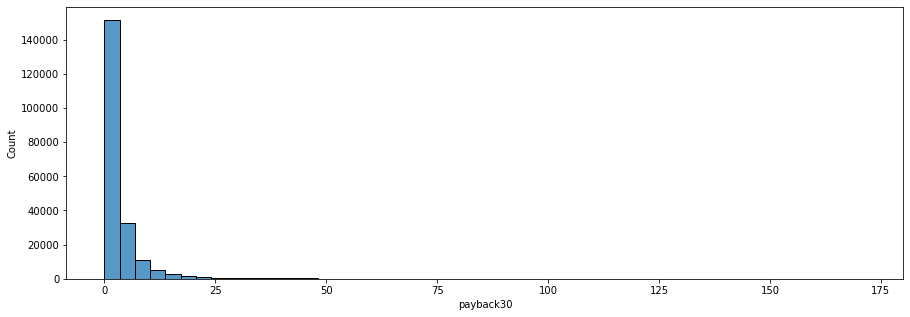

In [61]:
plt.figure(figsize=(15,5))
sns.histplot(x='payback30', data=defaulter, bins=50)

Mostly 198000 is Average payback time in days over last 30 days

<AxesSubplot:xlabel='payback90', ylabel='Count'>

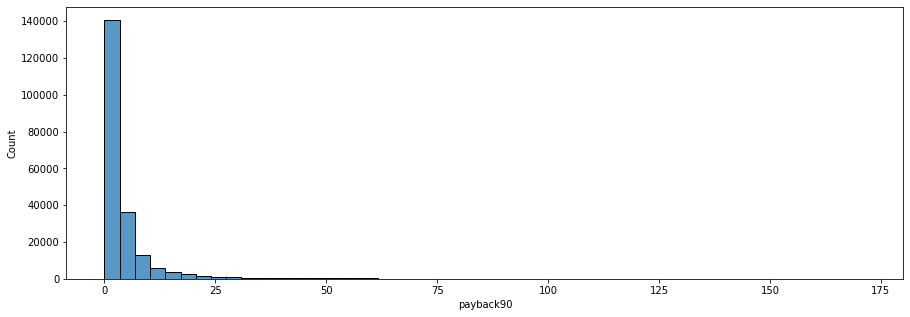

In [62]:
plt.figure(figsize=(15,5))
sns.histplot(x='payback90', data=defaulter, bins=50)

Mostly 140000 is Average payback time in days over last 90 days

<AxesSubplot:xlabel='month', ylabel='Count'>

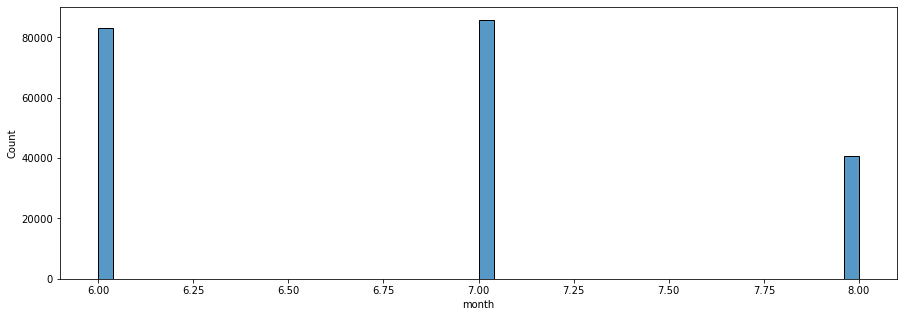

In [63]:
plt.figure(figsize=(15,5))
sns.histplot(x='month', data=defaulter, bins=50)

Most credit is 85000 in 7th month

<AxesSubplot:xlabel='day', ylabel='Count'>

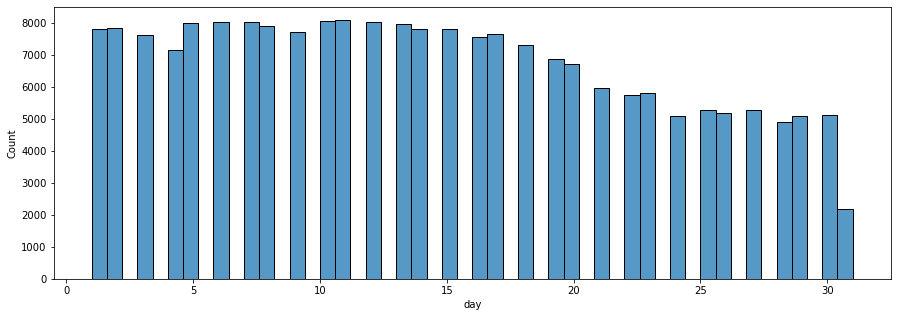

In [64]:
plt.figure(figsize=(15,5))
sns.histplot(x='day', data=defaulter, bins=50)

Most credit is on 11th day

## Bivariate Analysis
### Using Barplot

<AxesSubplot:xlabel='label', ylabel='aon'>

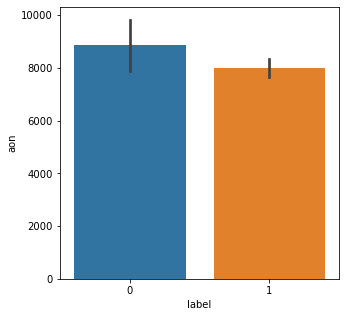

In [65]:
#BarPlot for comparision between "aon" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="aon",data=defaulter, x='label')

- Defaulter are most (More than 8500) compare to Non-Defaulter (More than 8000)

<AxesSubplot:xlabel='label', ylabel='daily_decr30'>

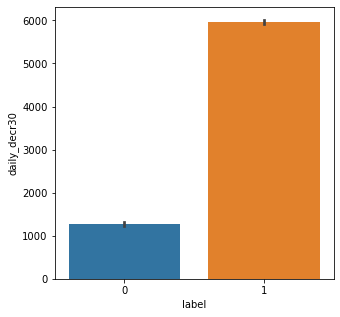

In [66]:
#BarPlot for comparision between "daily_decr30" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="daily_decr30",data=defaulter, x='label')

Non-Defaulter are most is 5900 compare to Defaulter is 1200

<AxesSubplot:xlabel='label', ylabel='daily_decr90'>

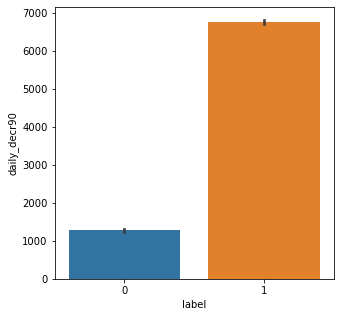

In [67]:
#BarPlot for comparision between "daily_decr90" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="daily_decr90",data=defaulter, x='label')

Non-Defaulter are most is 6800 compare to Defaulter is 1200

<AxesSubplot:xlabel='label', ylabel='rental30'>

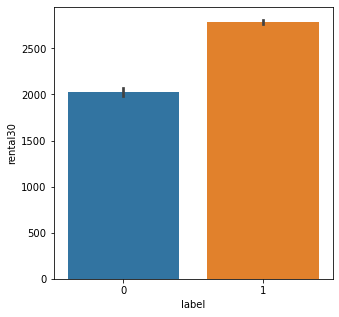

In [68]:
#BarPlot for comparision between "rental30" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="rental30",data=defaulter, x='label')

Non-Defaulter are more is 3000 compare to Defaulter is 2000

<AxesSubplot:xlabel='label', ylabel='rental90'>

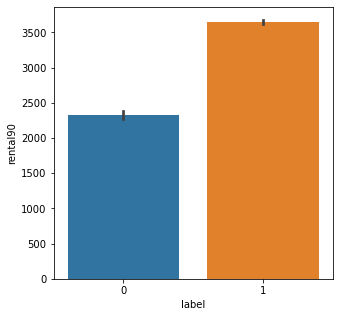

In [69]:
#BarPlot for comparision between "rental90" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="rental90",data=defaulter, x='label')

Non-Defaulter are most is 3200 compare to Defaulter is 2300

<AxesSubplot:xlabel='label', ylabel='last_rech_date_ma'>

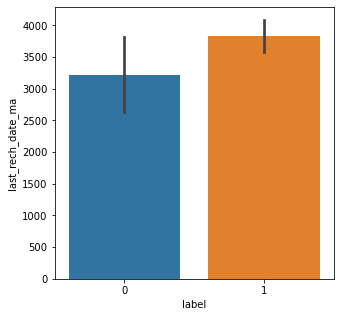

In [70]:
#BarPlot for comparision between "last_rech_date_ma" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="last_rech_date_ma",data=defaulter, x='label')

Non-Defaulter are more is 3800 compare to Defaulter is 3300

<AxesSubplot:xlabel='label', ylabel='last_rech_date_da'>

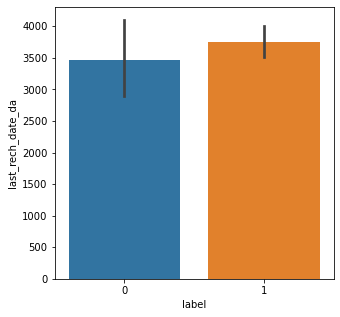

In [71]:
#BarPlot for comparision between "last_rech_date_da" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="last_rech_date_da",data=defaulter, x='label')

Non-Defaulter are more is 3800 compare to Defaulter is 3500

<AxesSubplot:xlabel='label', ylabel='last_rech_amt_ma'>

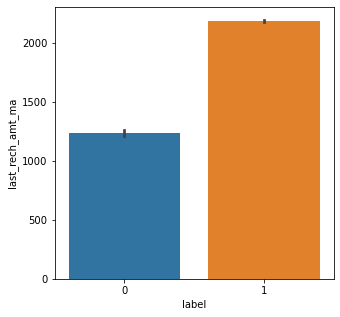

In [72]:
#BarPlot for comparision between "last_rech_amt_ma" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="last_rech_amt_ma",data=defaulter, x='label')

Non-Defaulter are more is 2300 compare to Defaulter is 1250

<AxesSubplot:xlabel='label', ylabel='cnt_ma_rech30'>

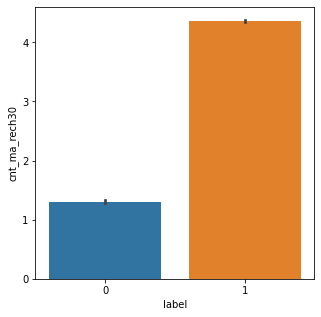

In [73]:
#BarPlot for comparision between "cnt_ma_rech30" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="cnt_ma_rech30",data=defaulter, x='label')

Non-Defaulter are more is 4.5 compare to Defaulter is 1.4

<AxesSubplot:xlabel='label', ylabel='fr_ma_rech30'>

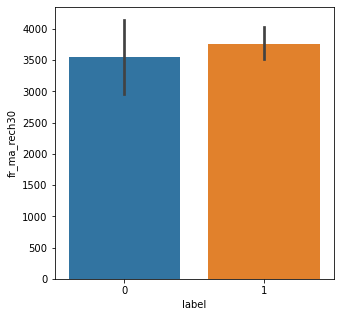

In [74]:
#BarPlot for comparision between "fr_ma_rech30" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="fr_ma_rech30",data=defaulter, x='label')

Non-Defaulter are more is 3800 compare to Defaulter is 3500

<AxesSubplot:xlabel='label', ylabel='sumamnt_ma_rech30'>

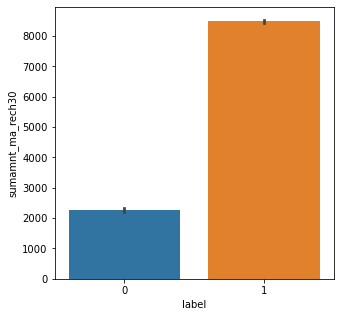

In [75]:
#BarPlot for comparision between "sumamnt_ma_rech30" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="sumamnt_ma_rech30",data=defaulter, x='label')

Non-Defaulter is more (Total No= 9000) compare to Defaulter (Total No= 2200)

<AxesSubplot:xlabel='label', ylabel='medianamnt_ma_rech30'>

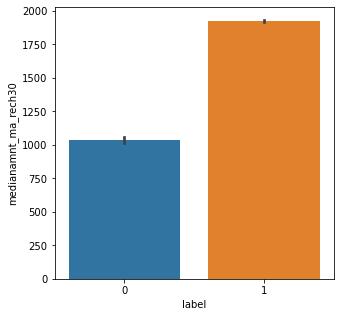

In [76]:
#BarPlot for comparision between "medianamnt_ma_rech30" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="medianamnt_ma_rech30",data=defaulter, x='label')

Non-Defaulter is more (Total No= 1950) compare to Defaulter (Total No= 1000)

<AxesSubplot:xlabel='label', ylabel='medianmarechprebal30'>

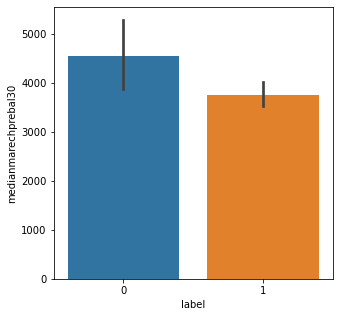

In [77]:
#BarPlot for comparision between "medianmarechprebal30" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="medianmarechprebal30",data=defaulter, x='label')

Defaulter is more (Total No= 4500) compare to Non-Defaulter (Total No= 3500)

<AxesSubplot:xlabel='label', ylabel='cnt_ma_rech90'>

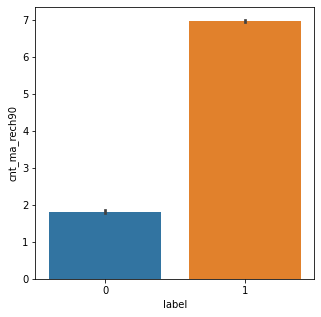

In [78]:
#BarPlot for comparision between "cnt_ma_rech90" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="cnt_ma_rech90",data=defaulter, x='label')

Non-Defaulter is more (Total No= 6.8) compare to Defaulter (Total No= 2.8)

<AxesSubplot:xlabel='label', ylabel='fr_ma_rech90'>

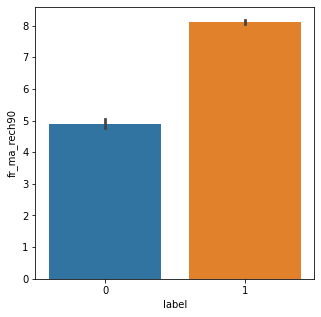

In [79]:
#BarPlot for comparision between "fr_ma_rech90" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="fr_ma_rech90",data=defaulter, x='label')

Non-Defaulter is more (Total No= 8) compare to Defaulter (Total No= 4.9)

<AxesSubplot:xlabel='label', ylabel='sumamnt_ma_rech90'>

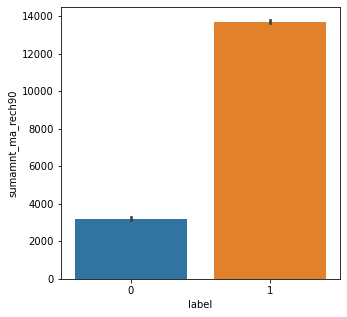

In [80]:
#BarPlot for comparision between "sumamnt_ma_rech90" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="sumamnt_ma_rech90",data=defaulter, x='label')

Non-Defaulter is more (Total No=13800) compare to Defaulter (Total No= 3500)

<AxesSubplot:xlabel='label', ylabel='medianamnt_ma_rech90'>

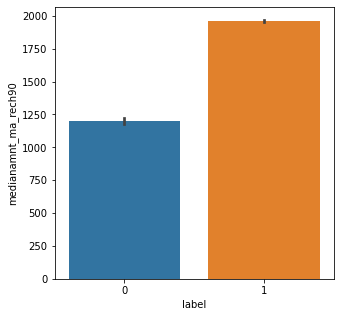

In [81]:
#BarPlot for comparision between "medianamnt_ma_rech90" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="medianamnt_ma_rech90",data=defaulter, x='label')

Non-Defaulter is more (Total No= 1950) compare to Defaulter (Total No= 1230)

<AxesSubplot:xlabel='label', ylabel='medianmarechprebal90'>

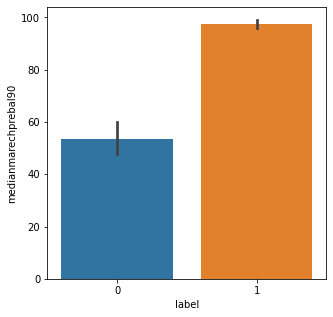

In [82]:
#BarPlot for comparision between "medianmarechprebal90" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="medianmarechprebal90",data=defaulter, x='label')

Non-Defaulter is more (Total No= 98) compare to Defaulter (Total No= 57)

<AxesSubplot:xlabel='label', ylabel='cnt_da_rech30'>

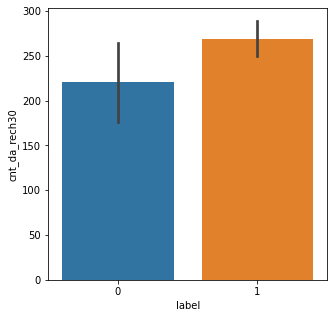

In [83]:
#BarPlot for comparision between "cnt_da_rech30" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="cnt_da_rech30",data=defaulter, x='label')

Non-Defaulter is more (Total No= 270) compare to Defaulter (Total No= 220)

<AxesSubplot:xlabel='label', ylabel='fr_da_rech30'>

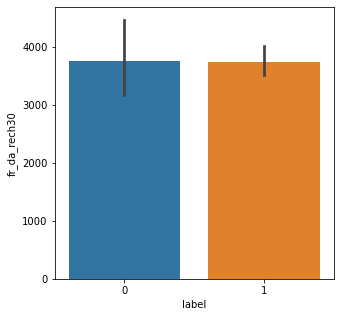

In [84]:
#BarPlot for comparision between "fr_da_rech30" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="fr_da_rech30",data=defaulter, x='label')

Non-Defaulter and Defaulter both are equal

<AxesSubplot:xlabel='label', ylabel='cnt_da_rech90'>

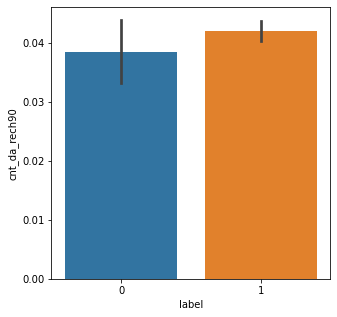

In [85]:
#BarPlot for comparision between "cnt_da_rech90" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="cnt_da_rech90",data=defaulter, x='label')

Non-Defaulter is more (Total No= 0.038) compare to Defaulter (Total No= 0.045)

<AxesSubplot:xlabel='label', ylabel='fr_da_rech90'>

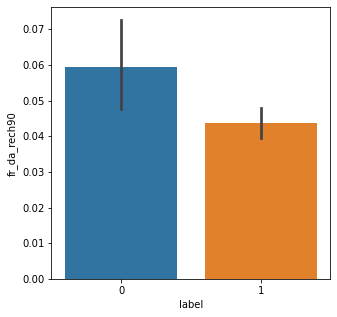

In [86]:
#BarPlot for comparision between "fr_da_rech90" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="fr_da_rech90",data=defaulter, x='label')

Defaulter is more (Total No= 0.045) compare to Non-Defaulter (Total No= 0.06)

<AxesSubplot:xlabel='label', ylabel='cnt_loans30'>

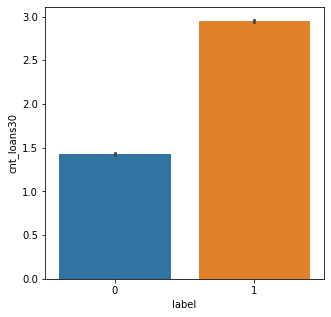

In [87]:
#BarPlot for comparision between "cnt_loans30" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="cnt_loans30",data=defaulter, x='label')

Non-Defaulter is more (Total No= 2.8) compare to Defaulter (Total No= 1.4)

<AxesSubplot:xlabel='label', ylabel='amnt_loans30'>

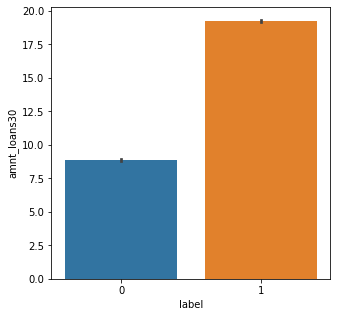

In [88]:
#BarPlot for comparision between "amnt_loans30" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="amnt_loans30",data=defaulter, x='label')

Non-Defaulter is more (Total No= 19.5) compare to Defaulter (Total No= 8.5)

<AxesSubplot:xlabel='label', ylabel='maxamnt_loans30'>

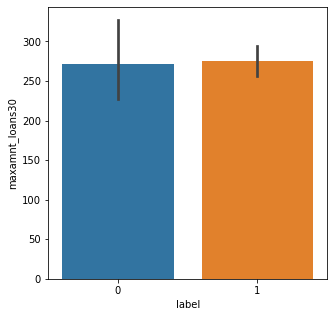

In [89]:
#BarPlot for comparision between "maxamnt_loans30" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="maxamnt_loans30",data=defaulter, x='label')

Non-Defaulter and Defaulter both are equal

<AxesSubplot:xlabel='label', ylabel='medianamnt_loans30'>

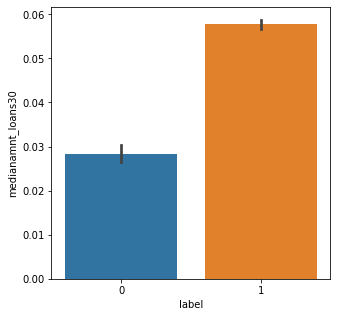

In [90]:
#BarPlot for comparision between "medianamnt_loans30" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="medianamnt_loans30",data=defaulter, x='label')

Non-Defaulter is more (Total No= 0.058) compare to Defaulter (Total No= 0.029)

<AxesSubplot:xlabel='label', ylabel='cnt_loans90'>

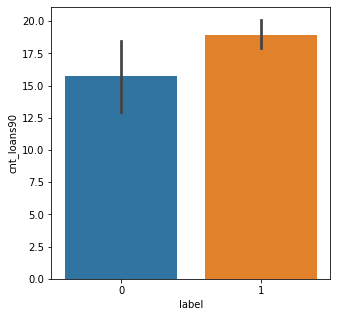

In [91]:
#BarPlot for comparision between "cnt_loans90" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="cnt_loans90",data=defaulter, x='label')

Non-Defaulter is more (Total No= 18.5) compare to Defaulter (Total No= 16)

<AxesSubplot:xlabel='label', ylabel='amnt_loans90'>

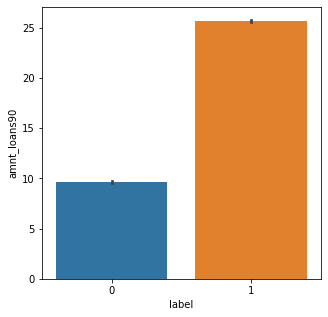

In [92]:
#BarPlot for comparision between "amnt_loans90" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="amnt_loans90",data=defaulter, x='label')

Non-Defaulter is more (Total No= 25) compare to Defaulter (Total No= 9)

<AxesSubplot:xlabel='label', ylabel='maxamnt_loans90'>

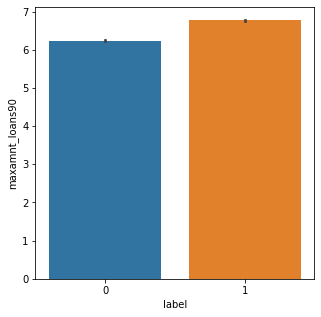

In [93]:
#BarPlot for comparision between "maxamnt_loans90" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="maxamnt_loans90",data=defaulter, x='label')

Non-Defaulter is more (Total No= 6.8) compare to Defaulter (Total No= 6.2)

<AxesSubplot:xlabel='label', ylabel='medianamnt_loans90'>

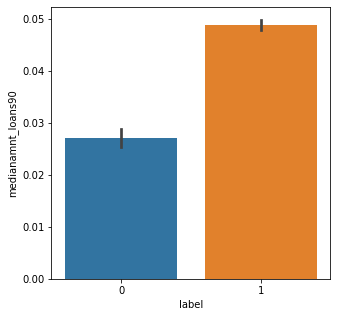

In [94]:
#BarPlot for comparision between "medianamnt_loans90" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="medianamnt_loans90",data=defaulter, x='label')

Non-Defaulter is more (Total No= 0.028) compare to Defaulter (Total No= 0.048)

<AxesSubplot:xlabel='label', ylabel='payback30'>

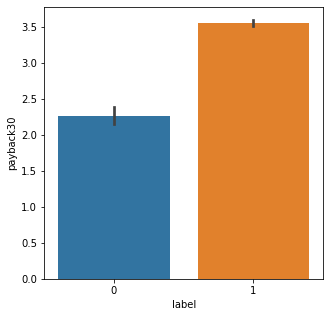

In [95]:
#BarPlot for comparision between "payback30" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="payback30",data=defaulter, x='label')

Non-Defaulter is more (Total No= 3.5) compare to Defaulter (Total No= 2.3)

<AxesSubplot:xlabel='label', ylabel='payback90'>

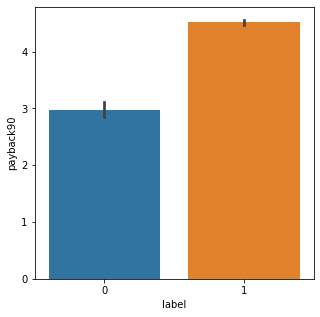

In [96]:
#BarPlot for comparision between "payback90" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="payback90",data=defaulter, x='label')

Non-Defaulter is more (Total No= 5) compare to Defaulter (Total No= 3)

<AxesSubplot:xlabel='label', ylabel='month'>

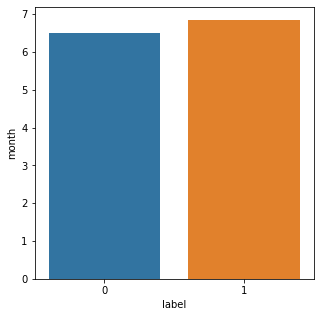

In [97]:
#BarPlot for comparision between "month" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="month",data=defaulter, x='label')

Non-Defaulter is little more (Total No= 6.8) compare to Defaulter (Total No= 6.5)

<AxesSubplot:xlabel='label', ylabel='day'>

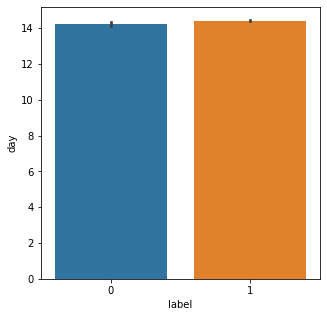

In [98]:
#BarPlot for comparision between "day" column and "label" column
plt.figure(figsize=(5,5))
sns.barplot(y="day",data=defaulter, x='label')

Day is equal for both Defaulter and Non-Defaulter.

## Multivariate Analysis
### Using Heatmap

<AxesSubplot:>

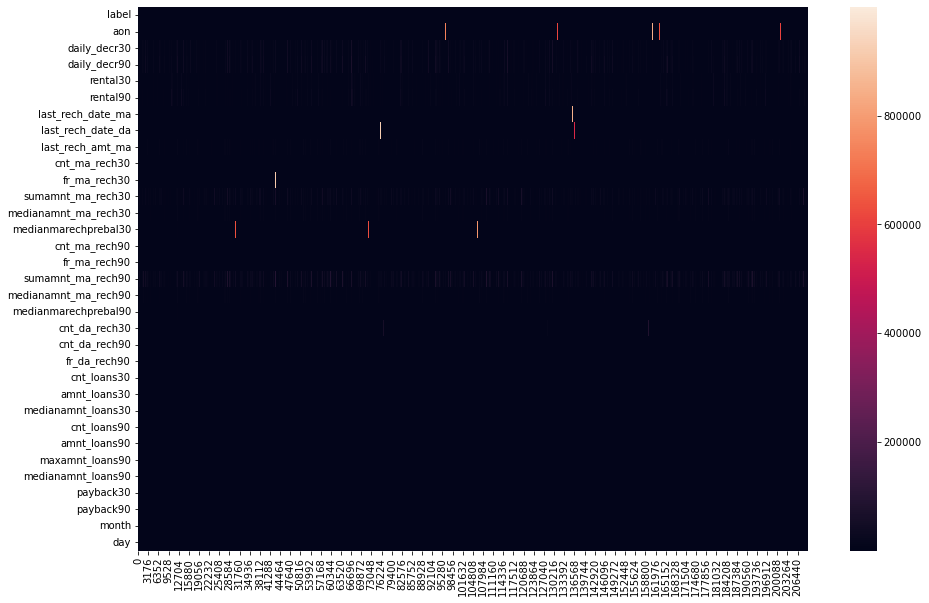

In [232]:
plt.figure(figsize=(15,10))
sns.heatmap(defaulter.transpose(),2)

We can observe relationship between all the continuous column and the target column by this pairplot in pairs which are plotted on basis of target column.

# Checking Correlation

In [102]:
defaulter.corr()

,label,aon,daily_decr30,daily_decr90,rental30,rental90,last_rech_date_ma,last_rech_date_da,last_rech_amt_ma,cnt_ma_rech30,fr_ma_rech30,sumamnt_ma_rech30,medianamnt_ma_rech30,medianmarechprebal30,cnt_ma_rech90,fr_ma_rech90,sumamnt_ma_rech90,medianamnt_ma_rech90,medianmarechprebal90,cnt_da_rech30,fr_da_rech30,cnt_da_rech90,fr_da_rech90,cnt_loans30,amnt_loans30,maxamnt_loans30,medianamnt_loans30,cnt_loans90,amnt_loans90,maxamnt_loans90,medianamnt_loans90,payback30,payback90,month,day
label,1.000000,-0.003785,0.168298,0.166150,0.058085,0.075521,0.003728,0.001711,0.131804,0.237331,0.001330,0.202828,0.141490,-0.004829,0.236392,0.084385,0.205793,0.120855,0.039300,0.003827,-0.000027,0.002999,-0.005418,0.196283,0.197272,0.000248,0.044589,0.004733,0.199788,0.084144,0.035747,0.048336,0.049183,0.154949,0.006825
aon,-0.003785,1.000000,0.001104,0.000374,-0.000960,-0.000790,0.001692,-0.001693,0.004256,-0.003148,-0.001163,0.000707,0.004306,0.003930,-0.002725,0.004401,0.001011,0.004909,-0.000859,0.001564,0.000892,0.001121,0.005395,-0.001826,-0.001726,-0.002764,0.004664,-0.000611,-0.002319,-0.001191,0.002771,0.001940,0.002203,-0.001863,0.000662
daily_decr30,0.168298,0.001104,1.000000,0.977704,0.442066,0.458977,0.000487,-0.001636,0.275837,0.451385,-0.000577,0.636536,0.295356,-0.001153,0.587338,-0.078299,0.762981,0.257847,0.037495,0.000700,-0.001499,0.038814,0.020673,0.366116,0.471492,-0.000028,-0.011610,0.008962,0.563496,0.400199,-0.037305,0.026915,0.047175,0.518664,0.006477
daily_decr90,0.166150,0.000374,0.977704,1.000000,0.434685,0.471730,0.000908,-0.001886,0.264131,0.426707,-0.000343,0.603886,0.282960,-0.000746,0.593069,-0.079530,0.768817,0.250518,0.036382,0.000661,-0.001570,0.031155,0.016437,0.340387,0.447869,0.000025,-0.005591,0.009446,0.567204,0.397251,-0.034686,0.019400,0.040800,0.539410,-0.021508
rental30,0.058085,-0.000960,0.442066,0.434685,1.000000,0.955237,-0.001095,0.003261,0.127271,0.233343,-0.001219,0.272649,0.129853,-0.001415,0.312118,-0.033530,0.342306,0.110356,0.027170,-0.001105,-0.002558,0.072255,0.046761,0.180203,0.233453,-0.000864,-0.016482,0.004012,0.298943,0.234211,-0.035489,0.072974,0.095147,0.365699,0.036537
rental90,0.075521,-0.000790,0.458977,0.471730,0.955237,1.000000,-0.001688,0.002794,0.121416,0.230260,-0.000503,0.259709,0.120242,-0.001237,0.345293,-0.036524,0.360601,0.103151,0.029547,-0.000548,-0.002345,0.056282,0.036886,0.171595,0.231906,-0.001411,-0.009467,0.005141,0.327436,0.251029,-0.034122,0.067110,0.099501,0.429407,0.008941
last_rech_date_ma,0.003728,0.001692,0.000487,0.000908,-0.001095,-0.001688,1.000000,0.001790,-0.000147,0.004311,-0.001629,0.002105,-0.001358,0.004071,0.004263,0.001414,0.002243,-0.000726,-0.001086,-0.003467,-0.003626,-0.003538,-0.002395,0.001193,0.000903,0.000928,0.001835,-0.000225,0.000870,-0.001123,0.002771,-0.002233,-0.001583,-0.001207,0.000560
last_rech_date_da,0.001711,-0.001693,-0.001636,-0.001886,0.003261,0.002794,0.001790,1.000000,-0.000149,0.001549,0.001158,0.000046,0.001037,0.002849,0.001272,0.000798,-0.000414,0.000219,0.004158,-0.003628,-0.000074,-0.001859,-0.000203,0.000380,0.000536,0.000503,0.000061,-0.000972,0.000519,0.001524,-0.002239,0.000077,0.000417,-0.001800,0.000631
last_rech_amt_ma,0.131804,0.004256,0.275837,0.264131,0.127271,0.121416,-0.000147,-0.000149,1.000000,-0.002662,0.002876,0.440821,0.794646,-0.002342,0.016707,0.106267,0.418735,0.818734,0.124646,-0.001837,-0.003230,0.014779,0.016042,-0.027612,0.008502,0.001000,0.028370,0.000093,0.014067,0.148460,0.021004,-0.027369,-0.014260,0.096919,0.028883
cnt_ma_rech30,0.237331,-0.003148,0.451385,0.426707,0.233343,0.230260,0.004311,0.001549,-0.002662,1.000000,0.001669,0.656986,-0.011792,0.000082,0.886433,-0.152759,0.584060,-0.051347,0.013463,0.002306,-0.002732,0.011981,0.006989,0.765802,0.752296,0.000109,-0.067011,0.014703,0.685257,0.174104,-0.071451,0.043617,0.017362,0.156148,0.068643


This gives the correlation between the denpendent and independent variables.

In [103]:
defaulter.corr()["label"].sort_values()

fr_da_rech90           -0.005418
medianmarechprebal30   -0.004829
aon                    -0.003785
fr_da_rech30           -0.000027
maxamnt_loans30         0.000248
fr_ma_rech30            0.001330
last_rech_date_da       0.001711
cnt_da_rech90           0.002999
last_rech_date_ma       0.003728
cnt_da_rech30           0.003827
cnt_loans90             0.004733
day                     0.006825
medianamnt_loans90      0.035747
medianmarechprebal90    0.039300
medianamnt_loans30      0.044589
payback30               0.048336
payback90               0.049183
rental30                0.058085
rental90                0.075521
maxamnt_loans90         0.084144
fr_ma_rech90            0.084385
medianamnt_ma_rech90    0.120855
last_rech_amt_ma        0.131804
medianamnt_ma_rech30    0.141490
month                   0.154949
daily_decr90            0.166150
daily_decr30            0.168298
cnt_loans30             0.196283
amnt_loans30            0.197272
amnt_loans90            0.199788
sumamnt_ma

## Checking correlation with heatmap

<AxesSubplot:>

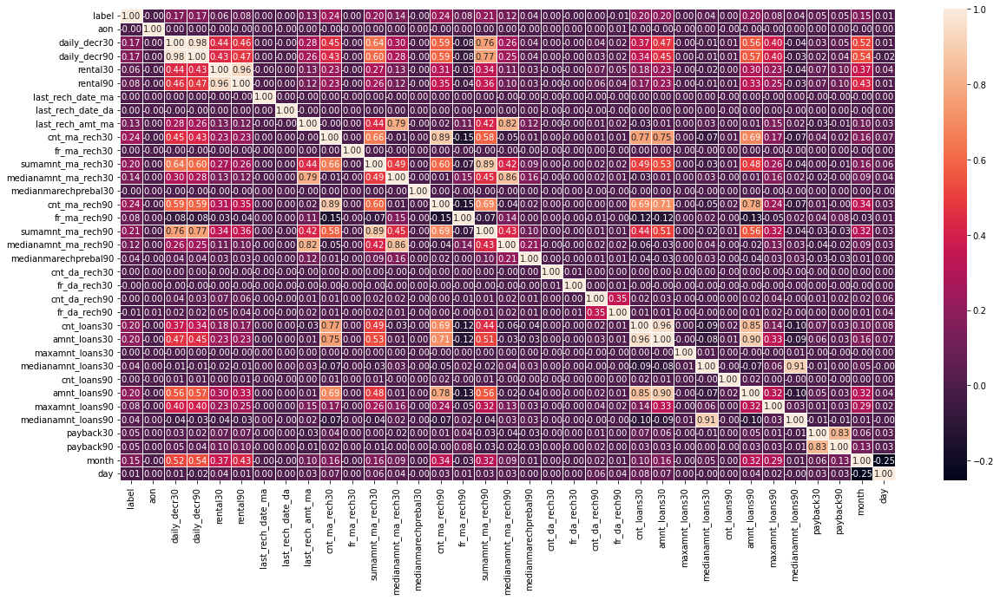

In [104]:
plt.figure(figsize=(20,10))
sns.heatmap(defaulter.corr(),annot=True,annot_kws= {"size": 10}, linewidth=0.5, linecolor='white', fmt='.2f')

aon                    -0
daily_decr30            17
daily_decr90            17
rental30                6
rental90                8
last_rech_date_ma       0
last_rech_date_da       0
last_rech_amt_ma        13
cnt_ma_rech30           24
fr_ma_rech30            0
sumamnt_ma_rech30       20
medianamnt_ma_rech30    14
medianmarechprebal30   -0
cnt_ma_rech90           24
fr_ma_rech90            8
sumamnt_ma_rech90       21
medianamnt_ma_rech90    12
medianmarechprebal90    4
cnt_da_rech30           0
fr_da_rech30           -0
cnt_da_rech90           0
fr_da_rech90           -0
cnt_loans30             20
amnt_loans30            20
maxamnt_loans30         0
medianamnt_loans30      4
cnt_loans90             0
amnt_loans90            20
maxamnt_loans90         8
medianamnt_loans90      4
payback30               5
payback90               5
month                   15
day                     0

## Checking correlation with barplot

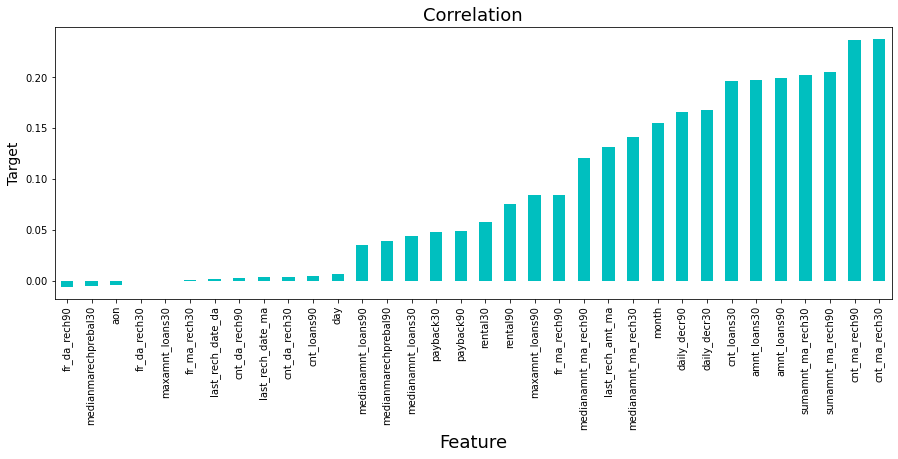

In [105]:
plt.figure(figsize=(15,5))
defaulter.corr()['label'].sort_values(ascending=True).drop(['label']).plot(kind='bar',color='c')
plt.xlabel('Feature',fontsize=18)
plt.ylabel('Target',fontsize=14)
plt.title('Correlation',fontsize=18)
plt.show()

### Observation:
- We can see there is no correlation between Target column and these two feature column 'fr_da_rech30' and 'maxamnt_loans30'. So, will drop these columns.
- column 'fr_da_rech90' is negatively highly correlated with target
- column 'cnt_ma_rech30' is positively highly correlated with target

##### Droping column 'fr_da_rech30' and 'maxamnt_loans30' 

In [106]:
defaulter.drop(columns=['fr_da_rech30', 'maxamnt_loans30'],inplace=True)

In [107]:
defaulter.columns

Index(['label', 'aon', 'daily_decr30', 'daily_decr90', 'rental30', 'rental90',
       'last_rech_date_ma', 'last_rech_date_da', 'last_rech_amt_ma',
       'cnt_ma_rech30', 'fr_ma_rech30', 'sumamnt_ma_rech30',
       'medianamnt_ma_rech30', 'medianmarechprebal30', 'cnt_ma_rech90',
       'fr_ma_rech90', 'sumamnt_ma_rech90', 'medianamnt_ma_rech90',
       'medianmarechprebal90', 'cnt_da_rech30', 'cnt_da_rech90',
       'fr_da_rech90', 'cnt_loans30', 'amnt_loans30', 'medianamnt_loans30',
       'cnt_loans90', 'amnt_loans90', 'maxamnt_loans90', 'medianamnt_loans90',
       'payback30', 'payback90', 'month', 'day'],
      dtype='object')

In [108]:
defaulter.shape

(209593, 33)

# Checking Outliers

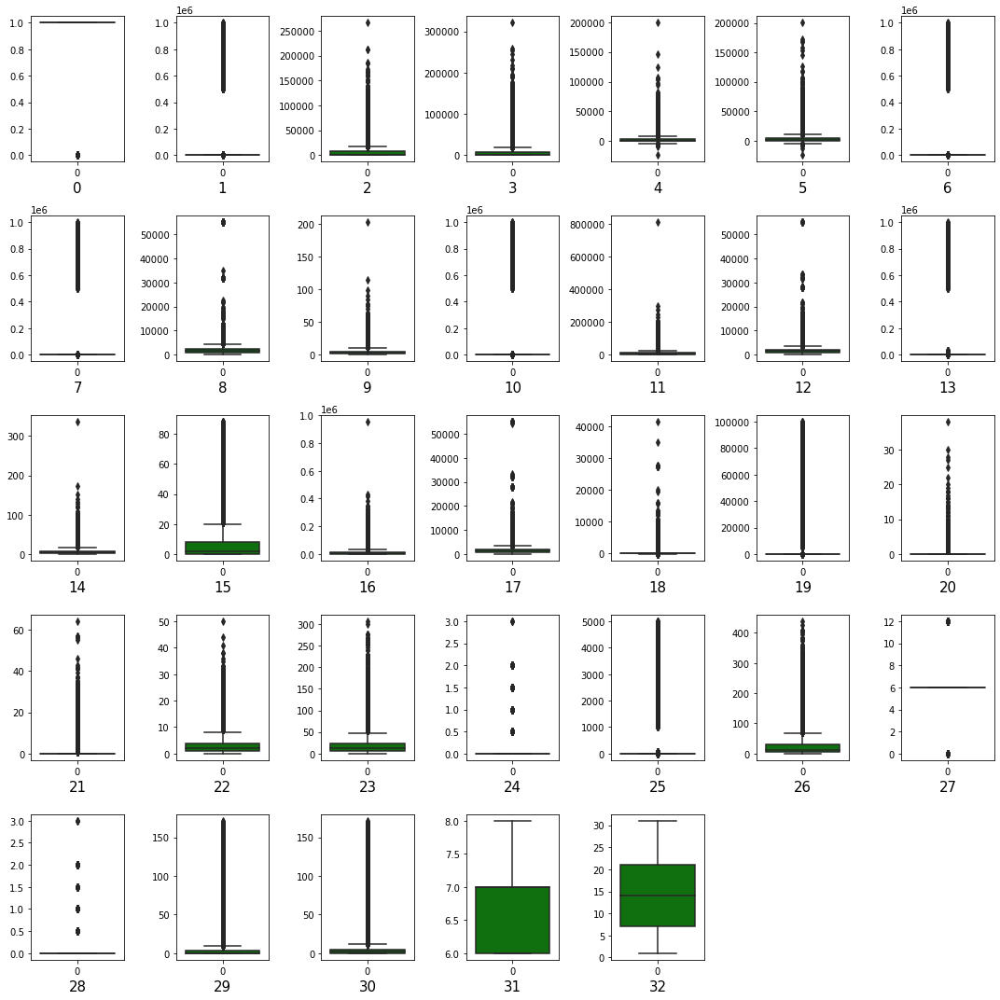

In [109]:
collist=defaulter.columns.values
ncol=33
nrows=7
plt.figure(figsize=(15,15))
for column in range(0,len(collist)):
    plt.subplot(5,7,column+1)
    sns.boxplot(data=defaulter[collist[column]],color='green',orient='v')
    plt.xlabel(column,fontsize=15)
    plt.tight_layout()

### Observation:
- __Outliers present in columns:__ 'label', 'aon', 'daily_decr30', 'daily_decr90', 'rental30', 'rental90','last_rech_date_ma',  'last_rech_date_da', 'last_rech_amt_ma', 'cnt_ma_rech30', 'fr_ma_rech30', 'sumamnt_ma_rech30', 'medianamnt_ma_rech30', 'medianmarechprebal30', 'cnt_ma_rech90','fr_ma_rech90', 'sumamnt_ma_rech90', 'medianamnt_ma_rech90', 'medianmarechprebal90', 'cnt_da_rech30',  'cnt_da_rech90', 'fr_da_rech90', 'cnt_loans30', 'amnt_loans30', 'medianamnt_loans30', 'cnt_loans90', 'amnt_loans90','maxamnt_loans90', 'medianamnt_loans90', 'payback30', 'payback90', 
- __Outliers not present in columns:__ 'month', 'day'

# Removing Outliers
## 1. Zscore method using Scipy

In [110]:
#We will not remove outliers from Target column 'label'
variable = defaulter[['aon', 'daily_decr30', 'daily_decr90', 'rental30', 'rental90','last_rech_date_ma', 
                      'last_rech_date_da', 'last_rech_amt_ma', 'cnt_ma_rech30', 'fr_ma_rech30', 'sumamnt_ma_rech30', 
                      'medianamnt_ma_rech30', 'medianmarechprebal30', 'cnt_ma_rech90','fr_ma_rech90', 'sumamnt_ma_rech90', 
                      'medianamnt_ma_rech90', 'medianmarechprebal90', 'cnt_da_rech30',  'cnt_da_rech90', 
                      'fr_da_rech90', 'cnt_loans30', 'amnt_loans30', 'medianamnt_loans30', 'cnt_loans90', 
                      'amnt_loans90','maxamnt_loans90', 'medianamnt_loans90', 'payback30', 'payback90']]

z1=np.abs(zscore(variable))

# Creating new dataframe
credit_defaulter = defaulter[(z1<3).all(axis=1)]
credit_defaulter.head()

,label,aon,daily_decr30,daily_decr90,rental30,rental90,last_rech_date_ma,last_rech_date_da,last_rech_amt_ma,cnt_ma_rech30,fr_ma_rech30,sumamnt_ma_rech30,medianamnt_ma_rech30,medianmarechprebal30,cnt_ma_rech90,fr_ma_rech90,sumamnt_ma_rech90,medianamnt_ma_rech90,medianmarechprebal90,cnt_da_rech30,cnt_da_rech90,fr_da_rech90,cnt_loans30,amnt_loans30,medianamnt_loans30,cnt_loans90,amnt_loans90,maxamnt_loans90,medianamnt_loans90,payback30,payback90,month,day
0,0,272.0,3055.050000,3065.150000,220.13,260.13,2.0,0.0,1539,2,21.0,3078.0,1539.0,7.50,2,21,3078,1539.0,7.50,0.0,0,0,2,12,0.0,2.0,12,6,0.0,29.000000,29.000000,7,20
1,1,712.0,12122.000000,12124.750000,3691.26,3691.26,20.0,0.0,5787,1,0.0,5787.0,5787.0,61.04,1,0,5787,5787.0,61.04,0.0,0,0,1,12,0.0,1.0,12,12,0.0,0.000000,0.000000,8,10
2,1,535.0,1398.000000,1398.000000,900.13,900.13,3.0,0.0,1539,1,0.0,1539.0,1539.0,66.32,1,0,1539,1539.0,66.32,0.0,0,0,1,6,0.0,1.0,6,6,0.0,0.000000,0.000000,8,19
3,1,241.0,21.228000,21.228000,159.42,159.42,41.0,0.0,947,0,0.0,0.0,0.0,0.00,1,0,947,947.0,2.50,0.0,0,0,2,12,0.0,2.0,12,6,0.0,0.000000,0.000000,6,6
4,1,947.0,150.619333,150.619333,1098.90,1098.90,4.0,0.0,2309,7,2.0,20029.0,2309.0,29.00,8,2,23496,2888.0,35.00,0.0,0,0,7,42,0.0,7.0,42,6,0.0,2.333333,2.333333,6,22


In [111]:
print("Old DataFrame data in Rows and Column:",defaulter.shape)
print("New DataFrame data in Rows and Column:",credit_defaulter.shape)
print("Total Dropped rows:",defaulter.shape[0]-credit_defaulter.shape[0])

Old DataFrame data in Rows and Column: (209593, 33)
New DataFrame data in Rows and Column: (163026, 33)
Total Dropped rows: 46567


### Percentage Data Loss using Zscore

In [112]:
loss_percent1=(209593-163026)/209593*100
print(loss_percent1,"%")

22.217822160091224 %


## 2. IQR (Inter Quantile Range) method

In [113]:
#1st quantile
Q1=variable.quantile(0.25)

# 3rd quantile
Q3=variable.quantile(0.75)

#IQR
IQR=Q3 - Q1
micro_defaulter=defaulter[~((defaulter < (Q1 - 1.5 * IQR)) |(defaulter > (Q3 + 1.5 * IQR))).any(axis=1)]

In [114]:
print("Old DataFrame data in Rows and Column:",defaulter.shape)
print("\nNew DataFrame data in Rows and Column:",micro_defaulter.shape)
print("\nTotal Dropped rows:",defaulter.shape[0]-micro_defaulter.shape[0])

Old DataFrame data in Rows and Column: (209593, 33)

New DataFrame data in Rows and Column: (71330, 33)

Total Dropped rows: 138263


### Percentage Data Loss using IQR

In [115]:
loss_perc1 = (209593-57328)/209593*100
print(loss_perc1,"%")

72.64794148659544 %


##### We can check by using IQR method there is large data loss in comparison to Zscore method. So, we will consider Zscore method.

# Checking Skewness

In [116]:
credit_defaulter.skew()

label                   -2.090282
aon                      0.958194
daily_decr30             1.963119
daily_decr90             2.077247
rental30                 2.195563
rental90                 2.244957
last_rech_date_ma        3.098605
last_rech_date_da       10.390692
last_rech_amt_ma         2.125025
cnt_ma_rech30            1.174958
fr_ma_rech30             2.005026
sumamnt_ma_rech30        1.635182
medianamnt_ma_rech30     2.325820
medianmarechprebal30    10.514000
cnt_ma_rech90            1.320723
fr_ma_rech90             1.984255
sumamnt_ma_rech90        1.706347
medianamnt_ma_rech90     2.372843
medianmarechprebal90     3.688959
cnt_da_rech30           51.006049
cnt_da_rech90            6.932690
fr_da_rech90             0.000000
cnt_loans30              1.465618
amnt_loans30             1.441398
medianamnt_loans30       5.355036
cnt_loans90              1.708099
amnt_loans90             1.694063
maxamnt_loans90          2.680114
medianamnt_loans90       6.100818
payback30     

### Observation:
- Skewness threshold taken is +/-0.50
- __Columns which are having skewness:__ 'label', 'aon', 'daily_decr30', 'daily_decr90', 'rental30', 'rental90', 'last_rech_date_ma', 'last_rech_date_da', 'last_rech_amt_ma', 'cnt_ma_rech30', 'fr_ma_rech30', 'sumamnt_ma_rech30', 'medianamnt_ma_rech30', 'medianmarechprebal30', 'cnt_ma_rech90', 'fr_ma_rech90', 'sumamnt_ma_rech90', 'medianamnt_ma_rech90', 'medianmarechprebal90', 'cnt_da_rech30', 'cnt_da_rech90',  'cnt_loans30', 'amnt_loans30', 'medianamnt_loans30', 'cnt_loans90', 'amnt_loans90', 'maxamnt_loans90', 'medianamnt_loans90', 'payback30', 'payback90'
       
- __Columns which are not having skewness:__ 'fr_da_rech90', 'month', 'day'

- Only the 'label' column data is negatively skewed and it is also our target column
- Column 'cnt_da_rech30' is highly positively skewed
- All the columns are not normallly distributed.
- We will not remove skewness from Target Column 'label'.

## Checking skweness through Data Visualization

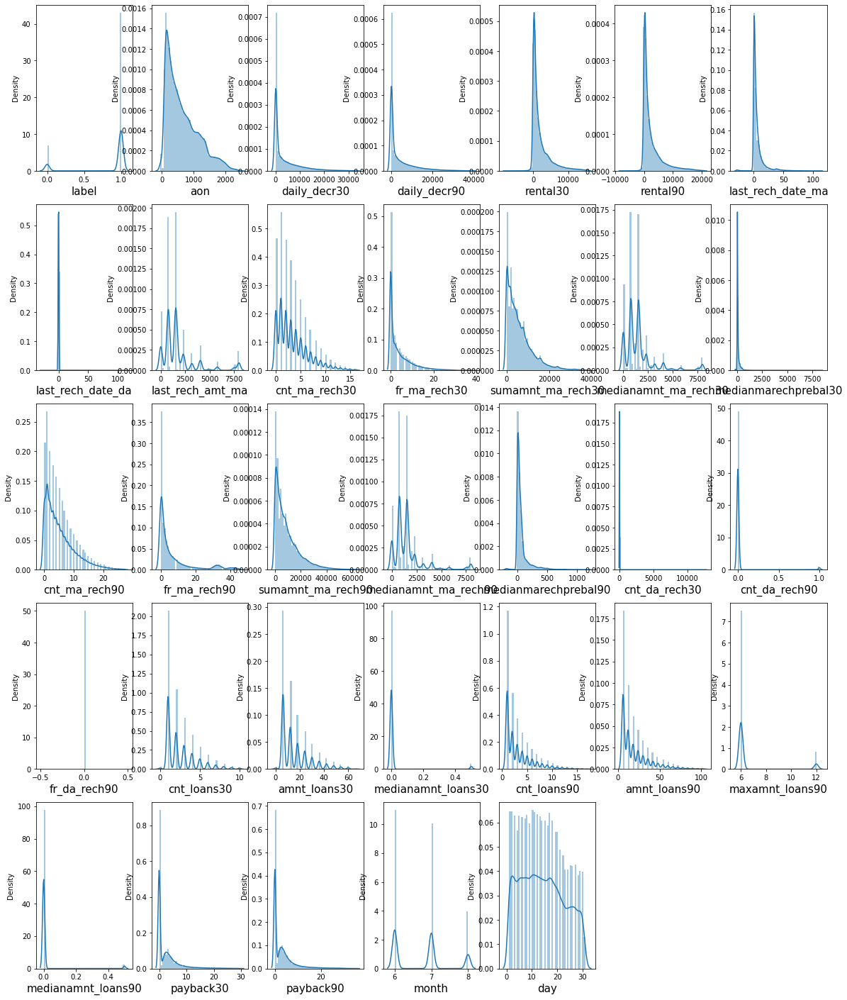

In [117]:
plt.figure(figsize=(20,25), facecolor='white')
plotnumber = 1

for column in credit_defaulter:
    if plotnumber<=33:
        ax = plt.subplot(5,7,plotnumber)
        sns.distplot(credit_defaulter[column])
        plt.xlabel(column,fontsize=15)
    plotnumber+=1
plt.show()

# Removing skewness using yeo-johnson method

In [118]:
from sklearn.preprocessing import PowerTransformer

In [119]:
collist1=['aon', 'daily_decr30', 'daily_decr90', 'rental30', 'rental90', 'last_rech_date_ma', 'last_rech_date_da', 
          'last_rech_amt_ma', 'cnt_ma_rech30', 'fr_ma_rech30', 'sumamnt_ma_rech30', 'medianamnt_ma_rech30', 
          'medianmarechprebal30', 'cnt_ma_rech90', 'fr_ma_rech90', 'sumamnt_ma_rech90', 'medianamnt_ma_rech90', 
          'medianmarechprebal90', 'cnt_da_rech30', 'cnt_da_rech90', 'cnt_loans30', 'amnt_loans30', 'medianamnt_loans30', 
          'cnt_loans90', 'amnt_loans90', 'maxamnt_loans90', 'medianamnt_loans90', 'payback30', 'payback90']
pt = PowerTransformer(method='yeo-johnson')
credit_defaulter[collist1] = pt.fit_transform(credit_defaulter[collist1])

### checking skewness after removal

credit_defaulter.skew()

### checking skewness after removal through data visualization using distplot

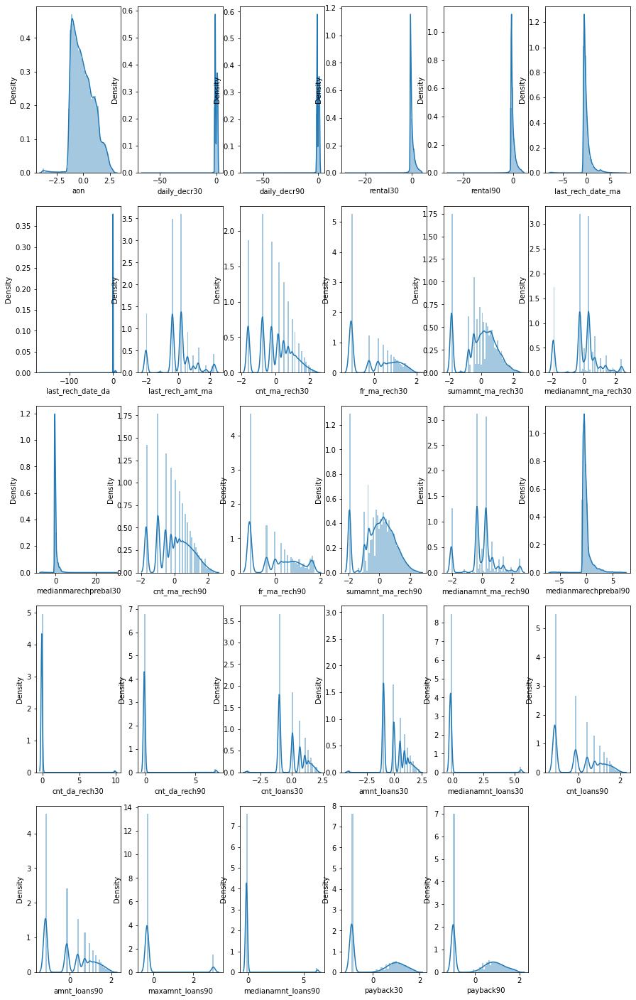

In [120]:
collist=['aon', 'daily_decr30', 'daily_decr90', 'rental30', 'rental90', 'last_rech_date_ma', 'last_rech_date_da', 
         'last_rech_amt_ma', 'cnt_ma_rech30', 'fr_ma_rech30', 'sumamnt_ma_rech30', 'medianamnt_ma_rech30', 
         'medianmarechprebal30', 'cnt_ma_rech90', 'fr_ma_rech90', 'sumamnt_ma_rech90', 'medianamnt_ma_rech90', 
         'medianmarechprebal90','cnt_da_rech30', 'cnt_da_rech90', 'cnt_loans30', 'amnt_loans30', 'medianamnt_loans30', 
         'cnt_loans90', 'amnt_loans90', 'maxamnt_loans90', 'medianamnt_loans90', 'payback30', 'payback90']
plt.figure(figsize=(15,25), facecolor='white')
plotnumber = 1

for column in credit_defaulter[collist]:
    if plotnumber<=29:
        ax = plt.subplot(5,6,plotnumber)
        sns.distplot(credit_defaulter[column])
        plt.xlabel(column,fontsize=10)
    plotnumber+=1
plt.show()

The data is not normal but the skewness has got removed compared to the old data.

# Data preprocessing
## Spliting data into Target and Features:

In [121]:
x=credit_defaulter.drop("label",axis=1)
y=credit_defaulter["label"]

In [122]:
x.head()

,aon,daily_decr30,daily_decr90,rental30,rental90,last_rech_date_ma,last_rech_date_da,last_rech_amt_ma,cnt_ma_rech30,fr_ma_rech30,sumamnt_ma_rech30,medianamnt_ma_rech30,medianmarechprebal30,cnt_ma_rech90,fr_ma_rech90,sumamnt_ma_rech90,medianamnt_ma_rech90,medianmarechprebal90,cnt_da_rech30,cnt_da_rech90,fr_da_rech90,cnt_loans30,amnt_loans30,medianamnt_loans30,cnt_loans90,amnt_loans90,maxamnt_loans90,medianamnt_loans90,payback30,payback90,month,day
0,-0.712297,0.582660,0.555598,-0.624890,-0.616794,-0.364567,-0.099221,0.181981,-0.246169,1.704555,-0.090681,0.306374,-0.438493,-0.538313,1.387711,-0.362541,0.249907,-0.510189,-0.101364,-0.141363,0,0.068701,-0.038884,-0.180648,-0.126238,-0.141638,-0.334407,-0.159732,1.845923,1.883358,7,20
1,0.262696,1.309589,1.255917,0.693145,0.436130,1.435815,-0.099221,1.760082,-0.777359,-1.105248,0.356065,1.881698,0.007816,-0.985108,-1.172817,0.032504,1.968233,0.010233,-0.101364,-0.141363,0,-0.987231,-0.038884,-0.180648,-1.118739,-0.141638,3.009665,-0.159732,-0.913236,-0.988248,8,10
2,-0.095609,0.239380,0.220925,-0.321585,-0.384763,-0.242427,-0.099221,0.181981,-0.777359,-1.105248,-0.483547,0.306374,0.046136,-0.985108,-1.172817,-0.711576,0.249907,0.056184,-0.101364,-0.141363,0,-0.987231,-0.985745,-0.180648,-1.118739,-1.167623,-0.334407,-0.159732,-0.913236,-0.988248,8,19
3,-0.795794,-0.987441,-0.983084,-0.656214,-0.659128,3.159851,-0.099221,-0.221974,-1.621580,-1.105248,-1.857048,-1.912177,-0.529240,-0.985108,-1.172817,-0.912802,-0.183023,-0.572398,-0.101364,-0.141363,0,0.068701,-0.038884,-0.180648,-0.126238,-0.141638,-0.334407,-0.159732,-0.913236,-0.988248,6,6
4,0.696476,-0.523008,-0.524342,-0.240988,-0.319129,-0.125792,-0.099221,0.582742,1.163872,0.169776,1.565462,0.706344,-0.240903,0.797141,-0.021515,1.265340,0.953298,-0.226361,-0.101364,-0.141363,0,1.712606,1.693360,-0.180648,1.361074,1.287876,-0.334407,-0.159732,0.680642,0.479947,6,22


In [123]:
y.head()

0    0
1    1
2    1
3    1
4    1
Name: label, dtype: int64

In [124]:
x.shape, y.shape

((163026, 32), (163026,))

In [125]:
y.value_counts()

1    140409
0     22617
Name: label, dtype: int64

# Oversampling using the SMOTE

In [126]:
from imblearn import under_sampling, over_sampling
from imblearn.over_sampling import SMOTE

In [127]:
SM = SMOTE()
x, y = SM.fit_resample(x,y)
y.value_counts()

0    140409
1    140409
Name: label, dtype: int64

# Scaling data using Standard Scaler

In [128]:
scaler = StandardScaler()
x = pd.DataFrame(scaler.fit_transform(x), columns = x.columns)

In [129]:
x.head()

,aon,daily_decr30,daily_decr90,rental30,rental90,last_rech_date_ma,last_rech_date_da,last_rech_amt_ma,cnt_ma_rech30,fr_ma_rech30,sumamnt_ma_rech30,medianamnt_ma_rech30,medianmarechprebal30,cnt_ma_rech90,fr_ma_rech90,sumamnt_ma_rech90,medianamnt_ma_rech90,medianmarechprebal90,cnt_da_rech30,cnt_da_rech90,fr_da_rech90,cnt_loans30,amnt_loans30,medianamnt_loans30,cnt_loans90,amnt_loans90,maxamnt_loans90,medianamnt_loans90,payback30,payback90,month,day
0,-0.608082,0.850174,0.828048,-0.575199,-0.563229,-0.405929,-0.094948,0.427654,0.132165,1.998858,0.290102,0.555370,-0.300723,-0.135918,1.632273,0.047375,0.475222,-0.372326,-0.092238,-0.126879,0.0,0.385671,0.271316,-0.157422,0.214918,0.208349,-0.277307,-0.142525,2.229614,2.231638,0.600151,0.716400
1,0.380640,1.578111,1.532010,0.775140,0.544701,1.226406,-0.094948,1.836774,-0.388058,-0.831620,0.706382,1.958990,0.170797,-0.574365,-0.893471,0.418096,1.993052,0.169997,-0.092238,-0.126879,0.0,-0.755058,0.271316,-0.157422,-0.829079,0.208349,3.617283,-0.142525,-0.675850,-0.722696,2.139139,-0.514390
2,0.017291,0.506417,0.491634,-0.264460,-0.319077,-0.295189,-0.094948,0.427654,-0.388058,-0.831620,-0.075973,0.555370,0.211282,-0.574365,-0.893471,-0.280170,0.475222,0.217881,-0.092238,-0.126879,0.0,-0.755058,-0.755515,-0.157422,-0.829079,-0.857337,-0.277307,-0.142525,-0.675850,-0.722696,2.139139,0.593321
3,-0.692754,-0.722107,-0.718638,-0.607291,-0.607775,2.789522,-0.094948,0.066955,-1.214847,-0.831620,-1.355809,-1.421367,-0.396596,-0.574365,-0.893471,-0.469006,0.092807,-0.437152,-0.092238,-0.126879,0.0,0.385671,0.271316,-0.157422,0.214918,0.208349,-0.277307,-0.142525,-0.675850,-0.722696,-0.938838,-1.006705
4,0.820528,-0.257029,-0.257510,-0.181888,-0.250014,-0.189440,-0.094948,0.785502,1.513092,0.452785,1.833306,0.911745,-0.091971,1.174584,0.242191,1.575024,1.096541,-0.076554,-0.092238,-0.126879,0.0,2.161592,2.149862,-0.157422,1.779398,1.693180,-0.277307,-0.142525,1.002543,0.787796,-0.938838,0.962558


# Checking for Multicolinearity

## VIF (Variance Inflation factor)

In [130]:
#1
vif = pd.DataFrame()
vif['VIF values']= [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif['Features'] = x.columns
vif

,VIF values,Features
0,1.032184,aon
1,600.160120,daily_decr30
2,638.768895,daily_decr90
3,19.856147,rental30
4,21.331380,rental90
5,2.294132,last_rech_date_ma
6,2.050320,last_rech_date_da
7,12.079582,last_rech_amt_ma
8,70.509087,cnt_ma_rech30
9,2.900613,fr_ma_rech30


##### The VIF value is more than 10 in the columns: 'daily_decr30', 'daily_decr90', 'rental30', 'rental90', 'last_rech_amt_ma', 'cnt_ma_rech30', 'sumamnt_ma_rech30', 'medianamnt_ma_rech30', 'cnt_ma_rech90', 'sumamnt_ma_rech90', 'medianamnt_ma_rech90', 'cnt_loans30', 'amnt_loans30', 'cnt_loans90', 'amnt_loans90'.  But column 'daily_decr90' is having highest VIF value. So, we will drop column 'daily_decr90' and also column 'fr_da_rech90' as it have no relation.

In [131]:
x.drop(['daily_decr90', 'fr_da_rech90'], axis =1, inplace=True)

In [132]:
x.columns

Index(['aon', 'daily_decr30', 'rental30', 'rental90', 'last_rech_date_ma',
       'last_rech_date_da', 'last_rech_amt_ma', 'cnt_ma_rech30',
       'fr_ma_rech30', 'sumamnt_ma_rech30', 'medianamnt_ma_rech30',
       'medianmarechprebal30', 'cnt_ma_rech90', 'fr_ma_rech90',
       'sumamnt_ma_rech90', 'medianamnt_ma_rech90', 'medianmarechprebal90',
       'cnt_da_rech30', 'cnt_da_rech90', 'cnt_loans30', 'amnt_loans30',
       'medianamnt_loans30', 'cnt_loans90', 'amnt_loans90', 'maxamnt_loans90',
       'medianamnt_loans90', 'payback30', 'payback90', 'month', 'day'],
      dtype='object')

In [133]:
x.shape

(280818, 30)

### Checking again Multicolinearity using VIF

In [134]:
#2
vif = pd.DataFrame()
vif['VIF values']= [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif['Features'] = x.columns
vif

,VIF values,Features
0,1.032045,aon
1,5.922329,daily_decr30
2,18.806772,rental30
3,20.241954,rental90
4,2.288115,last_rech_date_ma
5,2.050280,last_rech_date_da
6,12.074704,last_rech_amt_ma
7,70.456943,cnt_ma_rech30
8,2.898928,fr_ma_rech30
9,130.398813,sumamnt_ma_rech30


##### The VIF value is more than 10 in the columns: 'rental30', 'rental90', 'last_rech_amt_ma',  'cnt_ma_rech30', 'sumamnt_ma_rech30', 'medianamnt_ma_rech30', 'cnt_ma_rech90', 'sumamnt_ma_rech90', 'medianamnt_ma_rech90', 'cnt_loans30', 'amnt_loans30', 'cnt_loans90', 'amnt_loans90'. But column 'cnt_loans30' is having highest VIF value. So, we will drop column 'cnt_loans30' .

In [135]:
x.drop('cnt_loans30', axis =1, inplace=True)

### Checking again Multicolinearity using VIF

In [136]:
#3
vif = pd.DataFrame()
vif['VIF values']= [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif['Features'] = x.columns
vif

,VIF values,Features
0,1.031826,aon
1,5.922149,daily_decr30
2,18.770871,rental30
3,20.184867,rental90
4,2.288115,last_rech_date_ma
5,2.050252,last_rech_date_da
6,12.070516,last_rech_amt_ma
7,70.221039,cnt_ma_rech30
8,2.894328,fr_ma_rech30
9,130.386352,sumamnt_ma_rech30


##### The VIF value is more than 10 in the columns: 'rental30', 'rental90', 'last_rech_amt_ma', 'cnt_ma_rech30', 'sumamnt_ma_rech30', 'medianamnt_ma_rech30', 'cnt_ma_rech90', 'sumamnt_ma_rech90', 'medianamnt_ma_rech90', ''amnt_loans30', 'cnt_loans90', 'amnt_loans90'. But column 'amnt_loans90' is having highest VIF value. So, we will drop column 'amnt_loans90' .

In [137]:
x.drop('amnt_loans90', axis =1, inplace=True)

### Checking again Multicolinearity using VIF

In [138]:
#4
vif = pd.DataFrame()
vif['VIF values']= [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif['Features'] = x.columns
vif

,VIF values,Features
0,1.031619,aon
1,5.913623,daily_decr30
2,18.770793,rental30
3,20.183535,rental90
4,2.285124,last_rech_date_ma
5,2.050247,last_rech_date_da
6,12.069689,last_rech_amt_ma
7,70.219489,cnt_ma_rech30
8,2.889420,fr_ma_rech30
9,130.383157,sumamnt_ma_rech30


##### The VIF value is more than 10 in the columns: 'rental30', 'rental90', 'last_rech_amt_ma', 'cnt_ma_rech30', 'sumamnt_ma_rech30', 'medianamnt_ma_rech30', 'cnt_ma_rech90', 'sumamnt_ma_rech90', 'medianamnt_ma_rech90',  'cnt_loans90'.  But column 'sumamnt_ma_rech30' is having highest VIF value. So, we will drop column 'sumamnt_ma_rech30' .

In [139]:
x.drop('sumamnt_ma_rech30', axis =1, inplace=True)

### Checking again Multicolinearity using VIF

In [140]:
#5
vif = pd.DataFrame()
vif['VIF values']= [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif['Features'] = x.columns
vif

,VIF values,Features
0,1.031469,aon
1,5.900350,daily_decr30
2,18.726144,rental30
3,20.141754,rental90
4,2.282161,last_rech_date_ma
5,2.050230,last_rech_date_da
6,11.896533,last_rech_amt_ma
7,15.898012,cnt_ma_rech30
8,2.839815,fr_ma_rech30
9,8.108199,medianamnt_ma_rech30


##### The VIF value is more than 10 in the columns: 'rental30', 'rental90', 'last_rech_amt_ma', 'cnt_ma_rech30',  'cnt_ma_rech90', 'sumamnt_ma_rech90', 'medianamnt_ma_rech90', 'cnt_loans90'.  But column 'sumamnt_ma_rech90' is having highest VIF value. So, we will drop column 'sumamnt_ma_rech90' .

In [141]:
x.drop('sumamnt_ma_rech90', axis =1, inplace=True)

### Checking again Multicolinearity using VIF

In [142]:
#6
vif = pd.DataFrame()
vif['VIF values']= [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif['Features'] = x.columns
vif

,VIF values,Features
0,1.030012,aon
1,5.726690,daily_decr30
2,18.721385,rental30
3,20.128803,rental90
4,2.191578,last_rech_date_ma
5,2.050211,last_rech_date_da
6,11.729117,last_rech_amt_ma
7,15.380808,cnt_ma_rech30
8,2.827840,fr_ma_rech30
9,8.108132,medianamnt_ma_rech30


##### The VIF value is more than 10 in the columns: 'rental30', 'rental90', 'last_rech_amt_ma', 'cnt_ma_rech30',  'cnt_ma_rech90', 'medianamnt_ma_rech90', 'cnt_loans90'. But column 'rental90' is having highest VIF value. So, we will drop column 'rental90' .

In [143]:
x.drop('rental90', axis =1, inplace=True)

### Checking again Multicolinearity using VIF

In [144]:
#7
vif = pd.DataFrame()
vif['VIF values']= [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif['Features'] = x.columns
vif

,VIF values,Features
0,1.030008,aon
1,5.673777,daily_decr30
2,1.232620,rental30
3,2.188905,last_rech_date_ma
4,2.050211,last_rech_date_da
5,11.727489,last_rech_amt_ma
6,15.081414,cnt_ma_rech30
7,2.827258,fr_ma_rech30
8,8.102229,medianamnt_ma_rech30
9,3.458198,medianmarechprebal30


##### The VIF value is more than 10 in the columns: 'last_rech_amt_ma', 'cnt_ma_rech30',  'cnt_ma_rech90', 'medianamnt_ma_rech90', 'cnt_loans90'.. But column 'cnt_ma_rech90' is having highest VIF value. So, we will drop column 'cnt_ma_rech90' .

In [145]:
x.drop('cnt_ma_rech90', axis =1, inplace=True)

### Checking again Multicolinearity using VIF

In [146]:
#8
vif = pd.DataFrame()
vif['VIF values']= [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif['Features'] = x.columns
vif

,VIF values,Features
0,1.029592,aon
1,5.642060,daily_decr30
2,1.232390,rental30
3,2.106782,last_rech_date_ma
4,2.050010,last_rech_date_da
5,11.583026,last_rech_amt_ma
6,3.908607,cnt_ma_rech30
7,2.824556,fr_ma_rech30
8,7.584652,medianamnt_ma_rech30
9,3.457322,medianmarechprebal30


##### The VIF value is more than 10 in the columns: 'last_rech_amt_ma',  'medianamnt_ma_rech90', 'cnt_loans90'.  But column 'medianamnt_ma_rech90' is having highest VIF value. So, we will drop column 'medianamnt_ma_rech90' .

In [147]:
x.drop('medianamnt_ma_rech90', axis =1, inplace=True)

### Checking again Multicolinearity using VIF

In [148]:
#9
vif = pd.DataFrame()
vif['VIF values']= [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif['Features'] = x.columns
vif

,VIF values,Features
0,1.029544,aon
1,5.632878,daily_decr30
2,1.232352,rental30
3,1.895590,last_rech_date_ma
4,2.050010,last_rech_date_da
5,6.476984,last_rech_amt_ma
6,3.877563,cnt_ma_rech30
7,2.820513,fr_ma_rech30
8,5.901420,medianamnt_ma_rech30
9,3.441394,medianmarechprebal30


##### We can see still the VIF value is more than 10 in one column : 'cnt_loans90'. So, we will drop column 'cnt_loans90' .

In [149]:
x.drop('cnt_loans90', axis =1, inplace=True)

### Checking again Multicolinearity using VIF

In [150]:
#10
vif = pd.DataFrame()
vif['VIF values']= [variance_inflation_factor(x.values,i) for i in range(len(x.columns))]
vif['Features'] = x.columns
vif

,VIF values,Features
0,1.027349,aon
1,5.611635,daily_decr30
2,1.232003,rental30
3,1.895581,last_rech_date_ma
4,2.049953,last_rech_date_da
5,6.476568,last_rech_amt_ma
6,3.817574,cnt_ma_rech30
7,2.820106,fr_ma_rech30
8,5.900724,medianamnt_ma_rech30
9,3.438697,medianmarechprebal30


##### Now we can see there is no Multi-collinearaity present in columns. 

# Variance Threshold Method
It removes all features which variance doesn't meet some threshold. By default, it removes all zero-variance features.

In [151]:
var_threshold = VarianceThreshold(threshold=0)
var_threshold.fit(x)

VarianceThreshold(threshold=0)

In [152]:
var_threshold.get_support()

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True])

In [153]:
x.columns[var_threshold.get_support()]

Index(['aon', 'daily_decr30', 'rental30', 'last_rech_date_ma',
       'last_rech_date_da', 'last_rech_amt_ma', 'cnt_ma_rech30',
       'fr_ma_rech30', 'medianamnt_ma_rech30', 'medianmarechprebal30',
       'fr_ma_rech90', 'medianmarechprebal90', 'cnt_da_rech30',
       'cnt_da_rech90', 'amnt_loans30', 'medianamnt_loans30',
       'maxamnt_loans90', 'medianamnt_loans90', 'payback30', 'payback90',
       'month', 'day'],
      dtype='object')

In [154]:
# taking  out  all the  constant  columns 
cons_columns = [column for column in x.columns
               if column not in x.columns[var_threshold.get_support()]]
print(len(cons_columns))

0


##### So we can see that, with the help of variance threshold method, we got to know all the features here are important. So now we will use SelectKBest method.

# SelectKBest method

In [155]:
best_fit = SelectKBest(score_func = f_classif, k ='all')
fit = best_fit.fit(x,y)
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(x.columns)

In [156]:
fit = best_fit.fit(x,y)
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(x.columns)
dfcolumns.head()
featureScores = pd.concat([dfcolumns,dfscores],axis = 1)
featureScores.columns = ['Feature', 'Score']
print(featureScores.nlargest(22,'Score'))

                 Feature          Score
6          cnt_ma_rech30  101783.397056
14          amnt_loans30   64913.597672
19             payback90   55365.381061
18             payback30   52029.339759
7           fr_ma_rech30   50644.667733
8   medianamnt_ma_rech30   50118.339711
1           daily_decr30   44095.074655
5       last_rech_amt_ma   43281.317843
10          fr_ma_rech90   42892.304413
20                 month   15871.063042
9   medianmarechprebal30   14526.626902
11  medianmarechprebal90   13870.822251
0                    aon    6799.073944
16       maxamnt_loans90    6528.974017
3      last_rech_date_ma    3132.092005
2               rental30    2114.133012
15    medianamnt_loans30    1265.974298
17    medianamnt_loans90     679.709870
13         cnt_da_rech90     484.055385
4      last_rech_date_da     326.634343
12         cnt_da_rech30     194.096966
21                   day     158.755256


##### Selecting the best features based on above scores, we can see that the column "day" has most lowest features for the prediction, so we will drop this column.

In [157]:
x = x.drop([ "day"],axis=1)
x.shape

(280818, 21)

In [158]:
x.head()

,aon,daily_decr30,rental30,last_rech_date_ma,last_rech_date_da,last_rech_amt_ma,cnt_ma_rech30,fr_ma_rech30,medianamnt_ma_rech30,medianmarechprebal30,fr_ma_rech90,medianmarechprebal90,cnt_da_rech30,cnt_da_rech90,amnt_loans30,medianamnt_loans30,maxamnt_loans90,medianamnt_loans90,payback30,payback90,month
0,-0.608082,0.850174,-0.575199,-0.405929,-0.094948,0.427654,0.132165,1.998858,0.555370,-0.300723,1.632273,-0.372326,-0.092238,-0.126879,0.271316,-0.157422,-0.277307,-0.142525,2.229614,2.231638,0.600151
1,0.380640,1.578111,0.775140,1.226406,-0.094948,1.836774,-0.388058,-0.831620,1.958990,0.170797,-0.893471,0.169997,-0.092238,-0.126879,0.271316,-0.157422,3.617283,-0.142525,-0.675850,-0.722696,2.139139
2,0.017291,0.506417,-0.264460,-0.295189,-0.094948,0.427654,-0.388058,-0.831620,0.555370,0.211282,-0.893471,0.217881,-0.092238,-0.126879,-0.755515,-0.157422,-0.277307,-0.142525,-0.675850,-0.722696,2.139139
3,-0.692754,-0.722107,-0.607291,2.789522,-0.094948,0.066955,-1.214847,-0.831620,-1.421367,-0.396596,-0.893471,-0.437152,-0.092238,-0.126879,0.271316,-0.157422,-0.277307,-0.142525,-0.675850,-0.722696,-0.938838
4,0.820528,-0.257029,-0.181888,-0.189440,-0.094948,0.785502,1.513092,0.452785,0.911745,-0.091971,0.242191,-0.076554,-0.092238,-0.126879,2.149862,-0.157422,-0.277307,-0.142525,1.002543,0.787796,-0.938838


# Principle Component Analysis

In [159]:
from sklearn.decomposition import PCA

In [160]:
covar_matrix = PCA(n_components = len(x.columns))
covar_matrix.fit(x)

PCA(n_components=21)

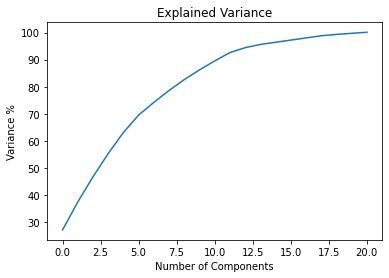

In [161]:
variance = covar_matrix.explained_variance_ratio_
var=np.cumsum(np.round(covar_matrix.explained_variance_ratio_, decimals=3)*100)

plt.figure()
plt.plot(var)
plt.xlabel('Number of Components')
plt.ylabel('Variance %')
plt.title('Explained Variance')
plt.show()

In [168]:
pca=PCA(n_components=7)
xpca=pca.fit_transform(x)
x=xpca

In [169]:
x

array([[-3.0327914 ,  0.69606896, -1.3342281 , ...,  0.93569336,
        -0.65389546, -0.50940247],
       [-1.72774143, -0.3600842 ,  1.14268057, ..., -3.42164766,
        -0.11970834, -0.61836058],
       [ 0.49302638, -0.16149263,  0.63717641, ..., -1.34070398,
         0.29941966, -0.13323955],
       ...,
       [ 3.36559747,  0.20636214, -0.58557364, ...,  0.56194504,
         0.73150624, -0.12361288],
       [ 3.17314715,  0.19760757, -0.68020634, ...,  0.2155392 ,
         0.82099843,  0.88591818],
       [ 0.27782825,  0.017362  , -0.04202793, ..., -1.97649953,
         0.16588447, -0.73080289]])

In [170]:
x=pd.DataFrame(data=x)

In [171]:
x.shape, y.shape

((280818, 7), (280818,))

In [172]:
x.head()

,0,1,2,3,4,5,6
0,-3.032791,0.696069,-1.334228,0.792872,0.935693,-0.653895,-0.509402
1,-1.727741,-0.360084,1.142681,-2.550114,-3.421648,-0.119708,-0.618361
2,0.493026,-0.161493,0.637176,-1.272235,-1.340704,0.299420,-0.133240
3,2.474896,-0.085099,0.397762,-0.437758,-0.397211,-1.131188,-0.123255
4,-2.168388,0.583583,-0.617894,0.683486,1.472997,-0.607251,0.801174


# Creating Model

We are using Classifier Models for prediction.

### Finding the best random state among all the models

In [173]:
maxAccu=0
maxRS=0
for i in range(1,100):
    x_train,x_test,y_train,y_test= train_test_split(x,y,test_size= .30, random_state= i)
    DTC = DecisionTreeClassifier()
    DTC.fit(x_train, y_train)
    pred = DTC.predict(x_test)
    acc=accuracy_score(y_test, pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Best accuracy is ",maxAccu," on Random_state ",maxRS)

Best accuracy is  0.791147354177053  on Random_state  48


## Creating train-test-split

In [174]:
# creating new train test split using the random state.
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size = .30, random_state = maxRS)

## 1. Logistic Regression

In [175]:
lr=LogisticRegression()
lr.fit(x_train,y_train)
pred_lr=lr.predict(x_test)

print("accuracy_score: ", accuracy_score(y_test, pred_lr))
print("confusion_matrix: \n", confusion_matrix(y_test, pred_lr))
print("classification_report: \n", classification_report(y_test,pred_lr))

accuracy_score:  0.7617334947653301
confusion_matrix: 
 [[32507  9498]
 [10575 31666]]
classification_report: 
               precision    recall  f1-score   support

           0       0.75      0.77      0.76     42005
           1       0.77      0.75      0.76     42241

    accuracy                           0.76     84246
   macro avg       0.76      0.76      0.76     84246
weighted avg       0.76      0.76      0.76     84246



### Confusion Matrix for Logistic Regression

Text(0.5, 1.0, 'Logistic regressor prediction Confusion_matrix')

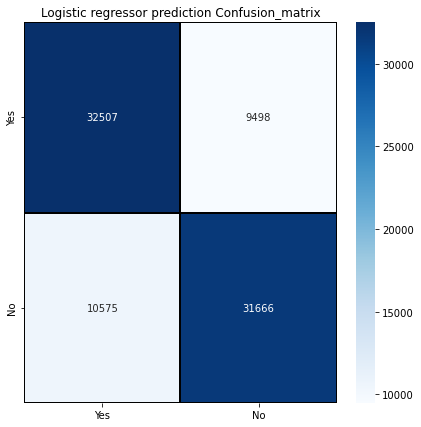

In [176]:
cm = confusion_matrix(y_test,pred_lr)
x_axis_labels = ["Yes","No"]
y_axis_labels = ["Yes","No"]

f , ax = plt.subplots(figsize=(7,7))
sns.heatmap(cm, annot = True,linewidths=.2, linecolor="black", fmt = ".0f", ax=ax, cmap="Blues", 
xticklabels=x_axis_labels,
yticklabels=y_axis_labels)
plt.title("Logistic regressor prediction Confusion_matrix")

## 2. Random Forest Classifier

In [177]:
rfc = RandomForestClassifier(n_estimators=100)
rfc.fit(x_train,y_train)
pred_rfc = rfc.predict(x_test)

print("accuracy_score: ",accuracy_score(y_test, pred_rfc))
print("confusion_matrix: \n",confusion_matrix(y_test, pred_rfc))
print("classification_report: \n",classification_report(y_test,pred_rfc))

accuracy_score:  0.853108752937825
confusion_matrix: 
 [[35710  6295]
 [ 6080 36161]]
classification_report: 
               precision    recall  f1-score   support

           0       0.85      0.85      0.85     42005
           1       0.85      0.86      0.85     42241

    accuracy                           0.85     84246
   macro avg       0.85      0.85      0.85     84246
weighted avg       0.85      0.85      0.85     84246



### Confusion Matrix for RFC

Text(0.5, 1.0, 'RFC prediction Confusion_matrix')

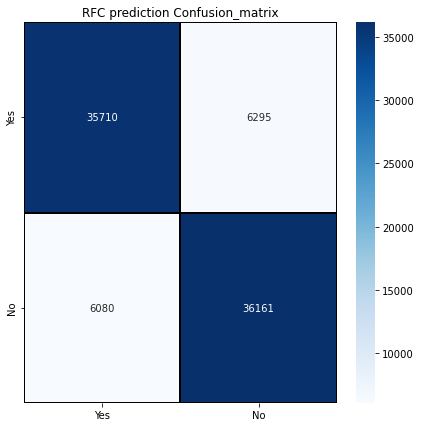

In [178]:
cm = confusion_matrix(y_test,pred_rfc)
x_axis_labels = ["Yes","No"]
y_axis_labels = ["Yes","No"]

f , ax = plt.subplots(figsize=(7,7))
sns.heatmap(cm, annot = True,linewidths=.2, linecolor="black", fmt = ".0f", ax=ax, cmap="Blues", 
xticklabels=x_axis_labels,
yticklabels=y_axis_labels)
plt.title("RFC prediction Confusion_matrix")

## 3. Decision Tree Classifier

In [179]:
dtc = DecisionTreeClassifier()
dtc.fit(x_train,y_train)
pred_dtc = dtc.predict(x_test)

print("accuracy_score: ",accuracy_score(y_test, pred_dtc))
print("confusion_matrix: \n",confusion_matrix(y_test, pred_dtc))
print("classification_report: \n",classification_report(y_test,pred_dtc))

accuracy_score:  0.791147354177053
confusion_matrix: 
 [[33801  8204]
 [ 9391 32850]]
classification_report: 
               precision    recall  f1-score   support

           0       0.78      0.80      0.79     42005
           1       0.80      0.78      0.79     42241

    accuracy                           0.79     84246
   macro avg       0.79      0.79      0.79     84246
weighted avg       0.79      0.79      0.79     84246



### Confusion Matrix for DTC

Text(0.5, 1.0, 'DTC prediction Confusion_matrix')

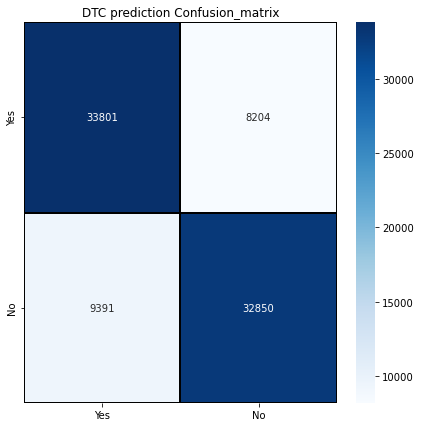

In [180]:
cm = confusion_matrix(y_test,pred_dtc)
x_axis_labels = ["Yes","No"]
y_axis_labels = ["Yes","No"]

f , ax = plt.subplots(figsize=(7,7))
sns.heatmap(cm, annot = True,linewidths=.2, linecolor="black", fmt = ".0f", ax=ax, cmap="Blues", 
xticklabels=x_axis_labels,
yticklabels=y_axis_labels)
plt.title("DTC prediction Confusion_matrix")

## 4. KNN Classifier

In [181]:
knn = KNeighborsClassifier()
knn.fit(x_train,y_train)
pred_knn = knn.predict(x_test)

print("accuracy_score: ",accuracy_score(y_test, pred_knn))
print("confusion_matrix: \n",confusion_matrix(y_test, pred_knn))
print("classification_report: \n",classification_report(y_test,pred_knn))

accuracy_score:  0.8251192934976141
confusion_matrix: 
 [[36575  5430]
 [ 9303 32938]]
classification_report: 
               precision    recall  f1-score   support

           0       0.80      0.87      0.83     42005
           1       0.86      0.78      0.82     42241

    accuracy                           0.83     84246
   macro avg       0.83      0.83      0.82     84246
weighted avg       0.83      0.83      0.82     84246



### Confusion Matrix for KNN classifier

Text(0.5, 1.0, 'KNN prediction Confusion_matrix')

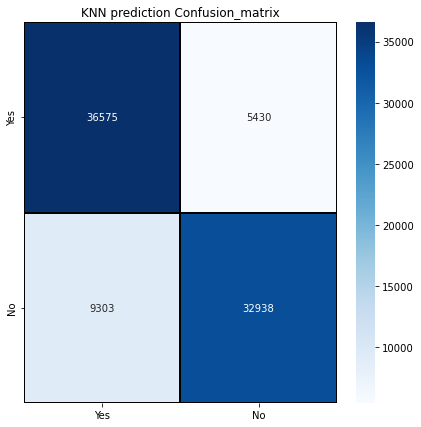

In [182]:
cm = confusion_matrix(y_test,pred_knn)
x_axis_labels = ["Yes","No"]
y_axis_labels = ["Yes","No"]

f , ax = plt.subplots(figsize=(7,7))
sns.heatmap(cm, annot = True,linewidths=.2, linecolor="black", fmt = ".0f", ax=ax, cmap="Blues", 
xticklabels=x_axis_labels,
yticklabels=y_axis_labels)
plt.title("KNN prediction Confusion_matrix")

## 5. Gradient Boosting Classifier

In [183]:
gb = GradientBoostingClassifier(n_estimators =100,learning_rate=0.1, max_depth=4)
gb.fit(x_train,y_train)
pred_gb = gb.predict(x_test)

print("accuracy_score: ",accuracy_score(y_test, pred_gb))
print("confusion_matrix: \n",confusion_matrix(y_test, pred_gb))
print("classification_report: \n",classification_report(y_test,pred_gb))

accuracy_score:  0.7868978942620422
confusion_matrix: 
 [[32539  9466]
 [ 8487 33754]]
classification_report: 
               precision    recall  f1-score   support

           0       0.79      0.77      0.78     42005
           1       0.78      0.80      0.79     42241

    accuracy                           0.79     84246
   macro avg       0.79      0.79      0.79     84246
weighted avg       0.79      0.79      0.79     84246



### Confusion Matrix for Gradient Boosting classifier

Text(0.5, 1.0, 'Gradient Boosting classifier prediction Confusion_matrix')

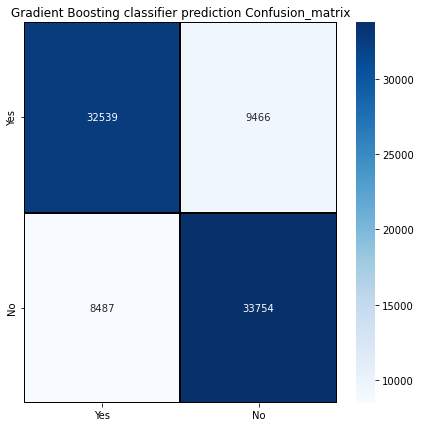

In [184]:
cm = confusion_matrix(y_test,pred_gb)
x_axis_labels = ["Yes","No"]
y_axis_labels = ["Yes","No"]

f , ax = plt.subplots(figsize=(7,7))
sns.heatmap(cm, annot = True,linewidths=.2, linecolor="black", fmt = ".0f", ax=ax, cmap="Blues", 
xticklabels=x_axis_labels,
yticklabels=y_axis_labels)
plt.title("Gradient Boosting classifier prediction Confusion_matrix")

##  6. XGBoost Classifier

In [185]:
from xgboost import XGBClassifier

In [186]:
XGBC= XGBClassifier()
XGBC.fit(x_train,y_train)
pred_XGBC = XGBC.predict(x_test)

print("accuracy_score: ",accuracy_score(y_test, pred_XGBC))
print("confusion_matrix: \n",confusion_matrix(y_test, pred_XGBC))
print("classification_report: \n",classification_report(y_test,pred_XGBC))

accuracy_score:  0.8045841939083161
confusion_matrix: 
 [[32989  9016]
 [ 7447 34794]]
classification_report: 
               precision    recall  f1-score   support

           0       0.82      0.79      0.80     42005
           1       0.79      0.82      0.81     42241

    accuracy                           0.80     84246
   macro avg       0.81      0.80      0.80     84246
weighted avg       0.80      0.80      0.80     84246



### Confusion Matrix for XGB Classifier

Text(0.5, 1.0, 'XGB Classifier prediction Confusion_matrix')

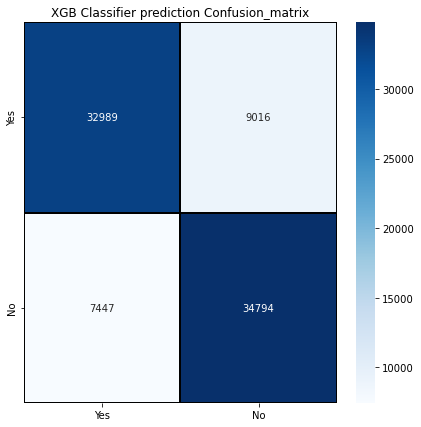

In [187]:
cm = confusion_matrix(y_test,pred_XGBC)
x_axis_labels = ["Yes","No"]
y_axis_labels = ["Yes","No"]

f , ax = plt.subplots(figsize=(7,7))
sns.heatmap(cm, annot = True,linewidths=.2, linecolor="black", fmt = ".0f", ax=ax, cmap="Blues", 
xticklabels=x_axis_labels,
yticklabels=y_axis_labels)
plt.title("XGB Classifier prediction Confusion_matrix")

# Cross Validation Score for all the model

In [189]:
#CV Score for Logistic Regression
print('CV score for Logistic Regression: ',cross_val_score(lr,x,y,cv=5).mean())

#CV Score for Random Forest Classifier
print('CV score for Random forest Classifier: ',cross_val_score(rfc,x,y,cv=5).mean())

#CV Score for Decision Tree Classifier
print('CV score for Decision Tree Classifier: ',cross_val_score(dtc,x,y,cv=5).mean())

#CV Score for KNN Classifier
print('CV score for KNN Classifier: ',cross_val_score(knn,x,y,cv=5).mean())

#CV Score for Gradient Boosting Classifier
print('CV score for Gradient Boosting Classifier: ',cross_val_score(gb,x,y,cv=5).mean())

#CV Score for XGB Classifier
print('CV score for XGB Classifier: ',cross_val_score(XGBC,x,y,cv=5).mean())

CV score for Logistic Regression:  0.7609020864662165
CV score for Random forest Classifier:  0.858741241237119
CV score for Decision Tree Classifier:  0.7942973754792039
CV score for KNN Classifier:  0.8331837565630222
CV score for Gradient Boosting Classifier:  0.7846648106909782
CV score for XGB Classifier:  0.8040439138861641


## ROC & AUC Curve for all model

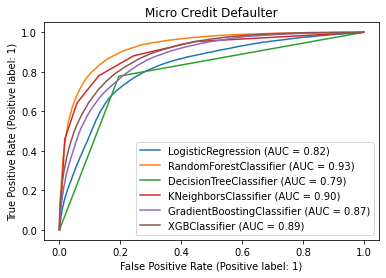

In [190]:
#Lets plot roc curve and check auc and performance of all algorithms
from sklearn.metrics import plot_roc_curve
disp = plot_roc_curve(lr, x_test, y_test)
plot_roc_curve(rfc, x_test, y_test, ax = disp.ax_)
plot_roc_curve(dtc, x_test, y_test, ax = disp.ax_)
plot_roc_curve(knn, x_test, y_test, ax = disp.ax_)
plot_roc_curve(gb, x_test, y_test, ax = disp.ax_)
plot_roc_curve(XGBC, x_test, y_test, ax = disp.ax_)
plt.title("Micro Credit Defaulter")
plt.legend(prop={"size" :10} ,loc = 'lower right')
plt.show()

# Hyper parameter tuning for best model using GridsearchCV
## The Random Forest Classifier with GridsearchCV

In [195]:
rfc=RandomForestClassifier(random_state=33,n_estimators=320)

In [196]:
parameters = {
    'n_estimators'      : [100, 320,330,340],
    'max_depth'         : [8, 9, 10, 11, 12],
    'random_state'      : [0]
}

In [201]:
clf = GridSearchCV(RandomForestClassifier(n_estimators=320), parameters, cv=5)

In [202]:
clf.fit(x_train, y_train)

RandomForestClassifier(n_estimators=320)

In [204]:
micro_credit_defaulter =RandomForestClassifier(n_estimators=320, random_state=33)
micro_credit_defaulter.fit(x_train, y_train)
pred = micro_credit_defaulter.predict(x_test)
# calculating the scores
print("accuracy score: ",accuracy_score(y_test,pred))
print("confusion_matrix: \n",confusion_matrix(y_test,pred))
print("classification_report: \n",classification_report(y_test,pred))

accuracy score:  0.8546043729079126
confusion_matrix: 
 [[35699  6306]
 [ 5943 36298]]
classification_report: 
               precision    recall  f1-score   support

           0       0.86      0.85      0.85     42005
           1       0.85      0.86      0.86     42241

    accuracy                           0.85     84246
   macro avg       0.85      0.85      0.85     84246
weighted avg       0.85      0.85      0.85     84246



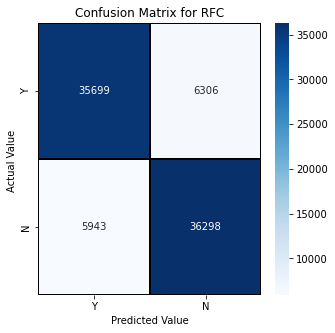

In [213]:
cm = confusion_matrix(y_test, pred)

x_axis_labels = ["Y","N"]
y_axis_labels = ["Y","N"]

f, ax = plt.subplots(figsize =(5,5))
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f", ax=ax, cmap="Blues", xticklabels=x_axis_labels, yticklabels=y_axis_labels)
plt.xlabel("Predicted Value")
plt.ylabel("Actual Value ")
plt.title('Confusion Matrix for RFC')
plt.show()

# ROC-AUC Curve

In [214]:
fpr,tpr,thresholds = roc_curve(y_test,pred,pos_label=True)

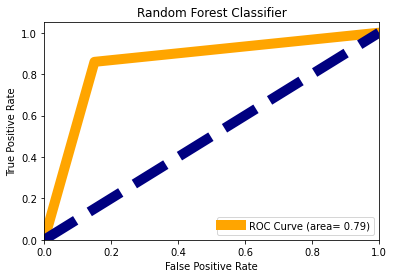

In [215]:
plt.figure()
plt.plot(fpr,tpr,color="orange",lw=10,label = "ROC Curve (area= %0.2f)" % acc)
plt.plot([0,1],[0,1],color="navy",lw=10,linestyle="--")
plt.xlim([0.0,1.0])
plt.ylim([0.0,1.05])
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Random Forest Classifier")
plt.legend(loc="lower right")
plt.show()

##### This is the AUC-ROC curve for the models which is plotted False positive rate against True positive rate. So the model has the area under curve as 0.79.

### Saving the Classification Model

In [206]:
filename='micro_credit_defaulter.pickle'
pickle.dump(rfc,open(filename,'wb'))
loaded_model = pickle.load(open(filename, 'rb'))

### Checking predicted and original values

In [209]:
a =np.array(y_test)
predicted=np.array(micro_credit_defaulter.predict(x_test))
Micro_Credit_Defaulter_Model=pd.DataFrame({'Orginal':a,'Predicted':predicted}, index=range(len(a)))
Micro_Credit_Defaulter_Model

,Orginal,Predicted
0,0,1
1,0,0
2,1,1
3,0,1
4,1,1
5,0,0
6,1,1
7,1,1
8,0,0
9,0,1


### Saving the model in CSV format

In [223]:
model =Micro_Credit_Defaulter_Model.to_csv('Micro_Credit_Defaulter_Model.csv')
model